# Instructions for using this notebook
To use this notebook, follow the instructions below to first install the required libraries. Once all the libraries are place, you can run the notebook by pressing the play button to run just one cell. To run the whole notebook use the double play button and click okay in the dialog that appears.
## Required libraries
1\. PYROSM <br>
2\. PANDAS <br>
3\. GEOPANDAS <br>
4\. GEOJSON <br>
5\. GEOJSONIO <br>
6\. JSON
### Install the libraries
if any library is missing, please use the intructions below to install them. If the instructions are note here then do a goole search with the reported error log for it. That should help.
#### Instructions for installing PYROSM
To perform the installation, please follow the instructions in the link:
__https://pyrosm.readthedocs.io/en/latest/installation.html__
#### Instructions for PANDAS
if Pandas is not already installed, follow the instructions in the link (use pip as instructed in the page): __https://pandas.pydata.org/docs/getting_started/install.html__ 
#### Instructions for GEOPANDAS
Usually the installation of PYROSM will install GEOPANDAS. if GEOPANDAS is not already installed, follow the instructions in the link (use pip as instructed in the page): __https://geopandas.org/en/stable/getting_started/install.html__
#### Instructions for GEOJSON
if GEOJSON is not already installed, follow the instructions in the link (use pip as instructed in the page): __https://pypi.org/project/geojson/__
#### Instructions for GEOJSONIO
This libray is used to display data in geojson format in map through the link: __https://geojson.io/#map=2/20.0/0.0__ <br>
To install GEOJSONIO, follow the instruction in the link: __https://pypi.org/project/geojsonio/__
#### Instructions for JSON
if it is not already in your Python environment then use: pip install json 

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
# import the needed libraries. The import is global
from pyrosm import OSM
from pyrosm import get_data

import geopandas
import pandas as pd

import geojson

import geojsonio

import pika

from turfpy.measurement import rhumb_bearing

import sys
import os
import datetime
from datetime import datetime
from datetime import timedelta


In [4]:
# path for user defined modules
modules_path = os.path.abspath(os.path.join('../python-modules'))
sys.path.insert(0, modules_path)

In [5]:
# import user defined python modules
import shapely_json_lines as sjl
import constant_data as cData
import GeometryData as gdata
import FeatureCollectionData as fcData
import neighbour_search as nb_s
import RoadNetworkManager as nManager
#import ConnectedLinesData
import CummulativeDistanceAndTime
import EnrichedCoordinates
import connectedsegments
import neighboursearch
import filterfunctions

In [6]:
# paths
data_path = "../../../data/"

In [7]:
# set the file containing the map data.
osm = OSM(data_path + "gothenburg.osm.pbf")

In [8]:
# Read road networks from the map
nodes, edges = osm.get_network(network_type="driving", nodes=True)

In [9]:
#edges.explore()

In [10]:
print(len(nodes))

360767


In [11]:
print(len(edges))

371683


In [12]:
nodes.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 360767 entries, 0 to 360766
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype   
---  ------     --------------   -----   
 0   lon        360767 non-null  float64 
 1   lat        360767 non-null  float64 
 2   tags       12684 non-null   object  
 3   timestamp  360767 non-null  int8    
 4   version    360767 non-null  int8    
 5   changeset  360767 non-null  int8    
 6   id         360767 non-null  int64   
 7   geometry   360767 non-null  geometry
dtypes: float64(2), geometry(1), int64(1), int8(3), object(1)
memory usage: 14.8+ MB


In [13]:
def filternetwork():
    return(edges[(edges['name'].isin(cData.selected_road_names)) | \
                     (edges['ref'].isin(cData.road_ref_list)) | \
                     (edges['id'].isin(cData.road_id_list)) | \
                     (edges['highway'].isin(["motorway_link",  "trunk_link", "trunk"]))]
          )

In [14]:
filtered_network_graph = filternetwork()

In [15]:
filtered_network_graph.explore()

In [16]:
filtered_network_graph.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 13945 entries, 42 to 370533
Data columns (total 38 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   access         141 non-null    object  
 1   area           0 non-null      object  
 2   bicycle        195 non-null    object  
 3   bridge         676 non-null    object  
 4   cycleway       12 non-null     object  
 5   foot           153 non-null    object  
 6   highway        13945 non-null  object  
 7   int_ref        2557 non-null   object  
 8   junction       672 non-null    object  
 9   lanes          10377 non-null  object  
 10  lit            2712 non-null   object  
 11  maxspeed       12547 non-null  object  
 12  motorcar       0 non-null      object  
 13  motorroad      25 non-null     object  
 14  motor_vehicle  2 non-null      object  
 15  name           6436 non-null   object  
 16  oneway         11822 non-null  object  
 17  overtaking     0 non-

In [17]:
def filternodes(rnetwork):
    return(nodes[(nodes['id'].isin(rnetwork.v)) | \
                (nodes['id'].isin(rnetwork.u))])

In [18]:
filtered_nodes = filternodes(filtered_network_graph)

(57.55, 57.875)

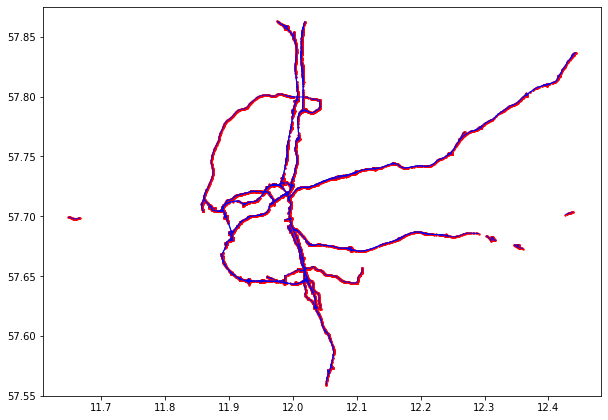

In [19]:
ax = filtered_network_graph.plot(figsize=(10,10), color="blue", lw=1.0)
ax = filtered_nodes.plot(ax=ax, color="red", markersize=2)
ax.set_ylim([57.55, 57.875])

<AxesSubplot:>

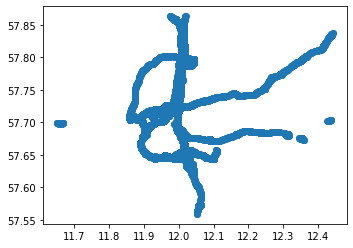

In [20]:
filtered_nodes.plot()

In [21]:
segments = [4040302, 284402021, 226048677]#, 13865743,13865744, 284402510]
gdf_test_segments = filtered_network_graph[filtered_network_graph['id'].isin(segments)]

In [22]:
filtered_nodes_test = filternodes(gdf_test_segments)

(57.855, 57.865)

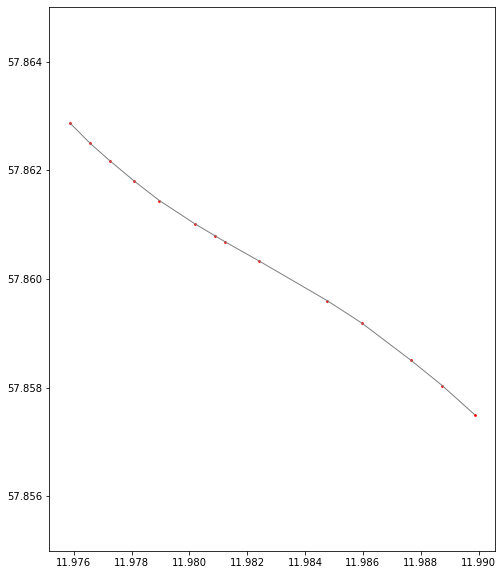

In [23]:
ax1 = gdf_test_segments.plot(figsize=(10,10), color="grey", lw=1.0)
ax1 = filtered_nodes_test.plot(ax=ax1, color="red", markersize=3)
ax1.set_ylim([57.855, 57.865])

In [24]:
filtered_network_graph = filtered_network_graph.loc[~filtered_network_graph["highway"].isin(['cycleway', 'footway', 'pedestrian', 'trail', 'crossing'])].copy()

In [25]:
filtered_nodes_test = filternodes(filtered_network_graph)

(57.55, 57.875)

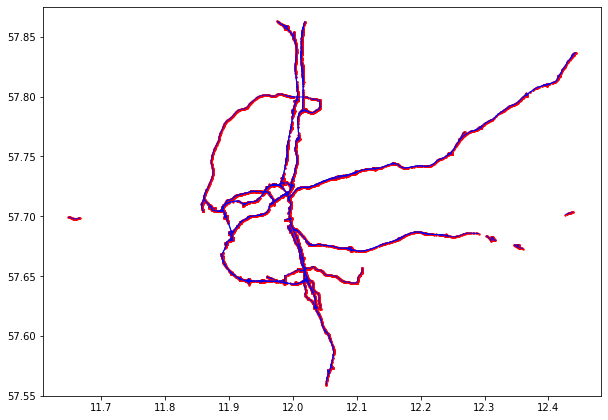

In [26]:
ax3 = filtered_network_graph.plot(figsize=(10,10), color="blue", lw=1.0)
ax3 = filtered_nodes_test.plot(ax=ax3, color="red", markersize=2)
ax3.set_ylim([57.55, 57.875])

In [27]:
filtered_network_graph = CummulativeDistanceAndTime.fixNAForMaxSpeed(filtered_network_graph)
filtered_network_graph["maxspeed"].unique()

<IntegerArray>
[100, 70, 60, 80, <NA>, 50, 90, 40, 30, 110]
Length: 10, dtype: Int64

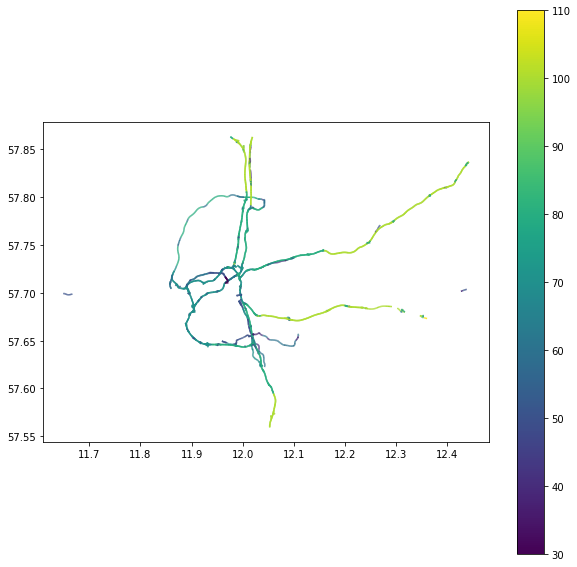

In [28]:
filtered_network_graph = CummulativeDistanceAndTime.replaceNAInMaxSpeed(filtered_network_graph)
ax = filtered_network_graph.plot(column="maxspeed", figsize=(10,10), legend=True)

In [29]:
print(nodes[nodes['id'].isin([2881481573])])

           lon        lat  tags  timestamp  version  changeset          id  \
202  11.980885  57.860795  None          0        0          0  2881481573   

                      geometry  
202  POINT (11.98088 57.86080)  


In [30]:
drive_net = osm.get_network(network_type="driving")

In [31]:
gdf_E6_graph = filtered_network_graph[filtered_network_graph['ref'] == 'E 6']

In [32]:
columns_to_drop = ['access', 'area', 'bicycle', 'cycleway', 'foot', 'lit', 'smoothness', \
                  'sidewalk', 'tags', 'version', 'timestamp', 'psv', 'int_ref']# not needed columns in the dataframe

In [33]:
def filternetworkExt(rNetwork):
    return(drive_net[(rNetwork['name'].isin(cData.selected_road_names)) | \
                     (rNetwork['ref'].isin(cData.road_ref_list)) | \
                     (rNetwork['id'].isin(cData.road_id_list)) | \
                     (rNetwork['highway'].isin(["motorway_link",  "trunk_link", "trunk"]))]
          )

In [34]:
def filterRoadNetwork(rNetwork):
    return(rNetwork[(rNetwork['name'].isin(cData.selected_road_names)) | \
                     (rNetwork['ref'].isin(cData.road_ref_list)) | \
                     (rNetwork['id'].isin(cData.road_id_list)) | \
                     (rNetwork['highway'].isin(["motorway_link",  "trunk_link", "trunk"]))]
          )

In [35]:
graphroadnetwork_E6 = filtered_network_graph[filtered_network_graph['ref'].isin(['E 6'])]

In [36]:
#graphroadnetwork_E6.explore()

In [37]:
ref_list = ['E 6', 'E 6.20', 'E 20', 'E 6;E 20', 'E 45']
nameslist = ['Oscarsleden']

In [38]:
large_graph = edges[(edges['name'].isin(nameslist)) | (edges['ref'].isin(ref_list))]

In [39]:
large_graph.explore()

In [40]:
filterfuncs = filterfunctions.filterfunctions()
filtered_network = drive_net[(drive_net['name'].isin(nameslist)) | (drive_net['ref'].isin(ref_list))] #filterfuncs.filterRoadNetwork(drive_net)

In [41]:
targetNetwork = drive_net[(drive_net['name'].isin(nameslist)) | (drive_net['ref'].isin(ref_list))]

In [42]:
roadNetworkManager_validator = nManager.RoadNetworkManager()

In [43]:
roadNetworkManager_validator.createlinesFromRoadGraphNetwork(targetNetwork, filtered_network, large_graph)

[]
[4040302]
[4040302, 284402021]
[4040302, 284402021, 226048677]
[4040302, 284402021, 226048677, 13865743]
[4040302, 284402021, 226048677, 13865743, 13865744]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754]
[4040302, 284402021, 226048677,

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130,

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 94

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 18315678

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226]
[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

145   144   284408726
284408726   1
146   145   165275002
165275002   1
147   146   1023025711
1023025711   1
148   147   1023025710
1023025710   1
149   148   284408727
150   149   284408727
151   150   284408727
284408727   3
152   151   284408724
153   152   284408724
284408724   2
154   153   215041210
215041210   1
155   154   1023025705
1023025705   1
156   155   1023025704
1023025704   1
157   156   284408723
158   157   284408723
159   158   284408723
160   159   284408723
284408723   4
161   160   620024876
162   161   620024876
620024876   2
163   162   284409597
284409597   1
164   163   214290381
165   164   214290381
166   165   214290381
214290381   3
167   166   1023025694
1023025694   1
168   167   1023025693
169   168   1023025693
1023025693   2
170   169   284409596
284409596   1
171   170   183028746
183028746   1
172   171   1023025691
1023025691   1
173   172   1023025690
1023025690   1
174   173   395613919
175   174   395613919
176   175   395613919
177   176   3

588   587   113713018
589   588   113713018
590   589   113713018
591   590   113713018
592   591   113713018
593   592   113713018
594   593   113713018
113713018   7
595   594   177388079
596   595   177388079
177388079   2
597   596   1023361824
1023361824   1
598   597   1023361825
1023361825   1
599   598   177388057
177388057   1
600   599   224204323
601   600   224204323
602   601   224204323
603   602   224204323
224204323   4
604   603   1054074518
1054074518   1
605   604   1054074519
606   605   1054074519
1054074519   2
607   606   1023361814
1023361814   1
608   607   1023361815
1023361815   1
609   608   224204322
224204322   1
610   609   224140163
611   610   224140163
612   611   224140163
613   612   224140163
614   613   224140163
615   614   224140163
616   615   224140163
617   616   224140163
618   617   224140163
619   618   224140163
620   619   224140163
621   620   224140163
622   621   224140163
623   622   224140163
624   623   224140163
625   624   2241401

{"coordinates": [[11.975858, 57.862876], [11.976574, 57.862493], [11.977244, 57.862179], [11.978085, 57.861805], [11.978966, 57.861442], [11.98018, 57.861019], [11.980885, 57.860795]], "type": "LineString"}
incoming line id -: None; this line id -: 4040302;  out going line id -: 284402021
{"coordinates": [[11.980885, 57.860795], [11.981231, 57.860686], [11.982417, 57.86033], [11.98476, 57.859604]], "type": "LineString"}
incoming line id -: 4040302; this line id -: 284402021;  out going line id -: 226048677
{"coordinates": [[11.98476, 57.859604], [11.985962, 57.85919], [11.987659, 57.858506], [11.988753, 57.858035], [11.989864, 57.857504]], "type": "LineString"}
incoming line id -: 284402021; this line id -: 226048677;  out going line id -: 13865743
{"coordinates": [[11.989864, 57.857504], [11.990503, 57.857161]], "type": "LineString"}
incoming line id -: 226048677; this line id -: 13865743;  out going line id -: 13865744
{"coordinates": [[11.990503, 57.857161], [11.991634, 57.85657], [

{"coordinates": [[11.983869, 57.731703], [11.983845, 57.731659], [11.983597, 57.731315], [11.983275, 57.730828]], "type": "LineString"}
incoming line id -: 1022912232; this line id -: 1022912231;  out going line id -: 1022912205
{"coordinates": [[11.983275, 57.730828], [11.983242, 57.730778]], "type": "LineString"}
incoming line id -: 1022912231; this line id -: 1022912205;  out going line id -: 1022912204
{"coordinates": [[11.983242, 57.730778], [11.983095, 57.730555]], "type": "LineString"}
incoming line id -: 1022912205; this line id -: 1022912204;  out going line id -: 222217359
{"coordinates": [[11.983095, 57.730555], [11.982911, 57.730266], [11.982735, 57.729951]], "type": "LineString"}
incoming line id -: 1022912204; this line id -: 222217359;  out going line id -: 1022912223
{"coordinates": [[11.982735, 57.729951], [11.982591, 57.729471], [11.982465, 57.729211]], "type": "LineString"}
incoming line id -: 222217359; this line id -: 1022912223;  out going line id -: 1022912222
{"

{"coordinates": [[12.001012, 57.688483], [12.001028, 57.688463]], "type": "LineString"}
incoming line id -: 182725088; this line id -: 1023578511;  out going line id -: 1023578506
{"coordinates": [[12.001028, 57.688463], [12.002056, 57.687205], [12.002909, 57.686168], [12.003349, 57.685639]], "type": "LineString"}
incoming line id -: 1023578511; this line id -: 1023578506;  out going line id -: 1023578505
{"coordinates": [[12.003349, 57.685639], [12.003374, 57.685608]], "type": "LineString"}
incoming line id -: 1023578506; this line id -: 1023578505;  out going line id -: 4077779
{"coordinates": [[12.003374, 57.685608], [12.004194, 57.684622], [12.005154, 57.683448], [12.005867, 57.68257], [12.006205, 57.682127], [12.006498, 57.681733], [12.00665, 57.681516], [12.006798, 57.681307], [12.006921, 57.681124]], "type": "LineString"}
incoming line id -: 1023578505; this line id -: 4077779;  out going line id -: 1023578494
{"coordinates": [[12.006921, 57.681124], [12.006959, 57.681073]], "ty

{"coordinates": [[12.048916, 57.605924], [12.04952, 57.605381], [12.050111, 57.604893], [12.050693, 57.604436], [12.051326, 57.603979], [12.051939, 57.60355], [12.052597, 57.603128], [12.053921, 57.602283], [12.054592, 57.601853], [12.05524, 57.601374], [12.055692, 57.600977], [12.056114, 57.600567], [12.056456, 57.600185], [12.056763, 57.59979], [12.057024, 57.599389], [12.057286, 57.598911], [12.057649, 57.598117], [12.057899, 57.597629]], "type": "LineString"}
incoming line id -: 4182405; this line id -: 296533439;  out going line id -: 935530539
{"coordinates": [[12.057899, 57.597629], [12.058112, 57.597278], [12.058344, 57.596938], [12.058794, 57.59631]], "type": "LineString"}
incoming line id -: 296533439; this line id -: 935530539;  out going line id -: 935530540
{"coordinates": [[12.058794, 57.59631], [12.059862, 57.594822]], "type": "LineString"}
incoming line id -: 935530539; this line id -: 935530540;  out going line id -: 4182406
{"coordinates": [[12.059862, 57.594822], [12

{"coordinates": [[12.260206, 57.763113], [12.259166, 57.762383], [12.258111, 57.761605], [12.257719, 57.761305], [12.257186, 57.760893], [12.256644, 57.760449], [12.256105, 57.76], [12.255665, 57.759621], [12.255059, 57.759068], [12.25453, 57.758605], [12.253817, 57.757957], [12.251613, 57.756013], [12.250459, 57.755162], [12.24884, 57.754119]], "type": "LineString"}
incoming line id -: 37016051; this line id -: 37016052;  out going line id -: 297012011
{"coordinates": [[12.260493, 57.763309], [12.260206, 57.763113]], "type": "LineString"}
incoming line id -: 480294687; this line id -: 37016051;  out going line id -: 37016052
{"coordinates": [[12.284969, 57.771846], [12.28323, 57.771612], [12.281663, 57.771463], [12.280313, 57.771296], [12.279444, 57.771161], [12.27857, 57.770988], [12.277622, 57.770756], [12.276672, 57.770472], [12.275661, 57.770133], [12.273426, 57.76938], [12.272206, 57.768962], [12.27065, 57.768441], [12.269948, 57.768204], [12.268872, 57.767839], [12.268451, 57.76

116614208   220  [ 11.9891923 , 57.7203702 ]
printing node
116614211   221  [ 11.9896399 , 57.7200707 ]
printing node
116614205   222  [ 11.9900116 , 57.7198182 ]
printing node
116614205   223  [ 11.990162 , 57.7197118 ]
printing node
116614205   224  [ 11.9903097 , 57.7196069 ]
printing node
116614212   225  [ 11.9904392 , 57.7195119 ]
printing node
41291138   226  [ 11.9905644 , 57.719416 ]
printing node
41291138   227  [ 11.9907631 , 57.7192742 ]
printing node
116614207   228  [ 11.9909817 , 57.7191058 ]
printing node
116614207   229  [ 11.9912869 , 57.7188347 ]
printing node
116614207   230  [ 11.9915469 , 57.7185888 ]
printing node
116614207   231  [ 11.9917738 , 57.718354 ]
printing node
116614207   232  [ 11.9919963 , 57.7181129 ]
printing node
118631478   233  [ 11.9921702 , 57.7179126 ]
printing node
118631478   234  [ 11.9922724 , 57.7177852 ]
printing node
118631478   235  [ 11.9924123 , 57.717618 ]
printing node
118631478   236  [ 11.9925457 , 57.7174452 ]
printing node
118

480294687   760  [ 12.2803132 , 57.7712956 ]
printing node
480294687   761  [ 12.2794442 , 57.7711611 ]
printing node
480294687   762  [ 12.2785703 , 57.7709882 ]
printing node
480294687   763  [ 12.2776225 , 57.7707557 ]
printing node
480294687   764  [ 12.2766718 , 57.7704724 ]
printing node
480294687   765  [ 12.2756606 , 57.7701334 ]
printing node
480294687   766  [ 12.2734264 , 57.7693796 ]
printing node
480294687   767  [ 12.2722059 , 57.7689618 ]
printing node
480294687   768  [ 12.2706503 , 57.7684411 ]
printing node
480294687   769  [ 12.2699475 , 57.7682037 ]
printing node
480294687   770  [ 12.268872 , 57.7678389 ]
printing node
480294687   771  [ 12.2684509 , 57.7676901 ]
printing node
480294687   772  [ 12.2678098 , 57.7674469 ]
printing node
480294687   773  [ 12.2668093 , 57.7670392 ]
printing node
480294687   774  [ 12.2662219 , 57.7667788 ]
printing node
480294687   775  [ 12.2659108 , 57.7666315 ]
printing node
480294687   776  [ 12.2654736 , 57.7664197 ]
printing nod

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

87   86   183156782
88   87   183156782
89   88   183156782
90   89   183156782
91   90   183156782
92   91   183156782
183156782   6
93   92   941040140
94   93   941040140
941040140   2
95   94   1023025761
1023025761   1
96   95   1023025760
1023025760   1
97   96   236557699
98   97   236557699
99   98   236557699
100   99   236557699
236557699   4
101   100   940731566
940731566   1
102   101   940731570
940731570   1
103   102   940731567
940731567   1
104   103   1023025749
1023025749   1
105   104   1023025748
1023025748   1
106   105   4077750
107   106   4077750
108   107   4077750
109   108   4077750
4077750   4
110   109   940731571
940731571   1
111   110   1023025746
1023025746   1
112   111   1023025745
1023025745   1
113   112   290070332
114   113   290070332
115   114   290070332
116   115   290070332
290070332   4
117   116   940731576
940731576   1
118   117   940731595
940731595   1
119   118   940731577
940731577   1
120   119   940731594
940731594   1
121   120  

507   506   935530540
935530540   1
508   507   4182406
509   508   4182406
510   509   4182406
511   510   4182406
512   511   4182406
513   512   4182406
514   513   4182406
515   514   4182406
516   515   4182406
517   516   4182406
518   517   4182406
519   518   4182406
520   519   4182406
521   520   4182406
522   521   4182406
523   522   4182406
524   523   4182406
525   524   4182406
526   525   4182406
527   526   4182406
4182406   20
528   527   935530565
529   528   935530565
935530565   2
530   529   935530566
935530566   1
531   530   935530567
532   531   935530567
533   532   935530567
935530567   3
534   533   935530568
535   534   935530568
935530568   2
536   535   935530569
537   536   935530569
538   537   935530569
539   538   935530569
540   539   935530569
541   540   935530569
542   541   935530569
543   542   935530569
935530569   8
544   543   937417553
545   544   937417553
546   545   937417553
547   546   937417553
548   547   937417553
937417553   5
549  

910   909   297042448
911   910   297042448
912   911   297042448
913   912   297042448
297042448   4
914   913   297042449
297042449   1
915   914   297042446
297042446   1
916   915   297042445
297042445   1
917   916   10275796
918   917   10275796
919   918   10275796
920   919   10275796
921   920   10275796
922   921   10275796
923   922   10275796
924   923   10275796
925   924   10275796
926   925   10275796
927   926   10275796
928   927   10275796
929   928   10275796
930   929   10275796
931   930   10275796
932   931   10275796
933   932   10275796
934   933   10275796
935   934   10275796
936   935   10275796
937   936   10275796
938   937   10275796
939   938   10275796
940   939   10275796
941   940   10275796
942   941   10275796
943   942   10275796
944   943   10275796
945   944   10275796
946   945   10275796
10275796   30
947   946   284402024
948   947   284402024
949   948   284402024
950   949   284402024
951   950   284402024
952   951   284402024
284402024   6


1368   1366   37434723
1369   1367   37434723
1370   1368   37434723
1371   1369   37434723
1372   1370   37434723
1373   1371   37434723
1374   1372   37434723
1375   1373   37434723
1376   1374   37434723
1377   1375   37434723
1378   1376   37434723
1379   1377   37434723
1380   1378   37434723
1381   1379   37434723
1382   1380   37434723
1383   1381   37434723
1384   1382   37434723
1385   1383   37434723
1386   1384   37434723
1387   1385   37434723
1388   1386   37434723
1389   1387   37434723
1390   1388   37434723
1391   1389   37434723
1392   1390   37434723
1393   1391   37434723
37434723   34
1394   1392   297012002
297012002   1
1395   1393   297012001
297012001   1
1396   1394   238455646
1397   1395   238455646
1398   1396   238455646
238455646   3
1399   1397   297012006
1400   1398   297012006
297012006   2
1401   1399   297012009
1402   1400   297012009
1403   1401   297012009
1404   1402   297012009
1405   1403   297012009
1406   1404   297012009
1407   1405   297012

1780   1778   182731875
1781   1779   182731875
1782   1780   182731875
1783   1781   182731875
1784   1782   182731875
1785   1783   182731875
1786   1784   182731875
1787   1785   182731875
1788   1786   182731875
1789   1787   182731875
1790   1788   182731875
1791   1789   182731875
1792   1790   182731875
1793   1791   182731875
1794   1792   182731875
1795   1793   182731875
1796   1794   182731875
1797   1795   182731875
1798   1796   182731875
182731875   19
1799   1797   937417557
937417557   1
1800   1798   937417558
1801   1799   937417558
1802   1800   937417558
1803   1801   937417558
1804   1802   937417558
1805   1803   937417558
1806   1804   937417558
1807   1805   937417558
1808   1806   937417558
1809   1807   937417558
1810   1808   937417558
1811   1809   937417558
1812   1810   937417558
1813   1811   937417558
1814   1812   937417558
937417558   15
1815   1813   996011177
996011177   1
1816   1814   996011178
996011178   1
1817   1815   440338457
1818   1816   44

{"coordinates": [[12.001068, 57.789586], [12.001052, 57.789552]], "type": "LineString"}
incoming line id -: 940731571; this line id -: 1023025746;  out going line id -: 1023025745
{"coordinates": [[12.001052, 57.789552], [12.000991, 57.789427]], "type": "LineString"}
incoming line id -: 1023025746; this line id -: 1023025745;  out going line id -: 290070332
{"coordinates": [[12.000991, 57.789427], [12.000808, 57.788969], [12.000597, 57.788433], [12.000293, 57.787475], [12.000027, 57.786588]], "type": "LineString"}
incoming line id -: 1023025745; this line id -: 290070332;  out going line id -: 940731576
{"coordinates": [[12.000027, 57.786588], [11.999803, 57.785562]], "type": "LineString"}
incoming line id -: 290070332; this line id -: 940731576;  out going line id -: 940731595
{"coordinates": [[11.999803, 57.785562], [11.9997, 57.78499]], "type": "LineString"}
incoming line id -: 940731576; this line id -: 940731595;  out going line id -: 940731577
{"coordinates": [[11.9997, 57.78499]

{"coordinates": [[11.993476, 57.715591], [11.99354, 57.715292]], "type": "LineString"}
incoming line id -: 1022912206; this line id -: 990532266;  out going line id -: 990532264
{"coordinates": [[11.99354, 57.715292], [11.99361, 57.715004]], "type": "LineString"}
incoming line id -: 990532266; this line id -: 990532264;  out going line id -: 118631484
{"coordinates": [[11.99361, 57.715004], [11.993814, 57.714695], [11.993892, 57.71448], [11.99401, 57.714034], [11.994078, 57.713815]], "type": "LineString"}
incoming line id -: 990532264; this line id -: 118631484;  out going line id -: 990532279
{"coordinates": [[11.994941, 57.715747], [11.99461, 57.715535], [11.994438, 57.715418], [11.994286, 57.715305], [11.994172, 57.715195], [11.994101, 57.715081], [11.994039, 57.714902], [11.994011, 57.714693], [11.994003, 57.714531], [11.994006, 57.714345], [11.994078, 57.713815]], "type": "LineString"}
incoming line id -: 1023059968; this line id -: 4040484;  out going line id -: 990532279
{"coord

incoming line id -: 296093115; this line id -: 937417546;  out going line id -: 937417547
{"coordinates": [[12.036198, 57.6228], [12.036371, 57.622406], [12.036564, 57.622032], [12.036745, 57.621729]], "type": "LineString"}
incoming line id -: 937417546; this line id -: 937417547;  out going line id -: 937417548
{"coordinates": [[12.036745, 57.621729], [12.037045, 57.621304], [12.037353, 57.620929], [12.037873, 57.620377]], "type": "LineString"}
incoming line id -: 937417547; this line id -: 937417548;  out going line id -: 937417550
{"coordinates": [[12.037873, 57.620377], [12.038347, 57.619946]], "type": "LineString"}
incoming line id -: 937417548; this line id -: 937417550;  out going line id -: 937417551
{"coordinates": [[12.038347, 57.619946], [12.038823, 57.619557], [12.039321, 57.61914], [12.040268, 57.618333], [12.040807, 57.617819]], "type": "LineString"}
incoming line id -: 937417550; this line id -: 937417551;  out going line id -: 937417552
{"coordinates": [[12.040807, 57.6

incoming line id -: 297012005; this line id -: 36834982;  out going line id -: 36834983
{"coordinates": [[12.161796, 57.743807], [12.1606, 57.743957], [12.15956, 57.744049]], "type": "LineString"}
incoming line id -: 297011998; this line id -: 297012005;  out going line id -: 36834982
{"coordinates": [[12.172395, 57.740668], [12.171368, 57.740848], [12.170305, 57.741077], [12.169225, 57.741391], [12.168267, 57.741713], [12.166841, 57.742303], [12.165495, 57.742832], [12.164793, 57.743087], [12.164174, 57.743286], [12.16362, 57.743432], [12.163015, 57.743576], [12.162329, 57.743715], [12.161796, 57.743807]], "type": "LineString"}
incoming line id -: 14676018; this line id -: 297011998;  out going line id -: 297012005
{"coordinates": [[12.18531, 57.741218], [12.18022, 57.740713], [12.178367, 57.740525], [12.17734, 57.740451], [12.176258, 57.740412], [12.175212, 57.740425], [12.174339, 57.740466], [12.173332, 57.740552], [12.172395, 57.740668]], "type": "LineString"}
incoming line id -: 1

incoming line id -: None; this line id -: 10275796;  out going line id -: 297042445
{"coordinates": [[11.980997, 57.860878], [11.980282, 57.861106], [11.97907, 57.861526], [11.978197, 57.86188], [11.97736, 57.862257], [11.976689, 57.86258], [11.975991, 57.862952]], "type": "LineString"}
incoming line id -: 226048674; this line id -: 284402024;  out going line id -: None
{"coordinates": [[11.983799, 57.86006], [11.982467, 57.860448], [11.980997, 57.860878]], "type": "LineString"}
incoming line id -: 619559320; this line id -: 226048674;  out going line id -: 284402024
{"coordinates": [[11.986647, 57.859053], [11.986062, 57.859284], [11.983799, 57.86006]], "type": "LineString"}
incoming line id -: 13865742; this line id -: 619559320;  out going line id -: 226048674
{"coordinates": [[11.990023, 57.857572], [11.988906, 57.858111], [11.987805, 57.858598], [11.986647, 57.859053]], "type": "LineString"}
incoming line id -: 13865741; this line id -: 13865742;  out going line id -: 619559320
{"

{"coordinates": [[11.981319, 57.727054], [11.981739, 57.727626], [11.981951, 57.727925]], "type": "LineString"}
incoming line id -: 58703991; this line id -: 1022912242;  out going line id -: 1022912241
{"coordinates": [[11.982693, 57.724943], [11.981766, 57.725648], [11.981628, 57.725776], [11.981477, 57.725954], [11.981362, 57.72611], [11.981275, 57.7263], [11.981244, 57.726449], [11.981241, 57.726618], [11.981264, 57.72684], [11.981319, 57.727054]], "type": "LineString"}
incoming line id -: 1022919212; this line id -: 58703991;  out going line id -: 1022912242
{"coordinates": [[11.982849, 57.724826], [11.982693, 57.724943]], "type": "LineString"}
incoming line id -: 1022919213; this line id -: 1022919212;  out going line id -: 58703991
{"coordinates": [[11.982955, 57.724746], [11.982849, 57.724826]], "type": "LineString"}
incoming line id -: 705749709; this line id -: 1022919213;  out going line id -: 1022919212
{"coordinates": [[11.983213, 57.724549], [11.982955, 57.724746]], "type

{"coordinates": [[12.105246, 57.737929], [12.105977, 57.738063]], "type": "LineString"}
incoming line id -: 297008483; this line id -: 232059516;  out going line id -: 39237215
{"coordinates": [[12.105977, 57.738063], [12.10694, 57.738243], [12.107574, 57.738354], [12.108607, 57.738499], [12.109667, 57.73864], [12.110629, 57.738746], [12.111634, 57.738844], [12.112805, 57.738927], [12.114182, 57.739007], [12.115872, 57.739108], [12.117535, 57.739196], [12.121741, 57.739451], [12.123324, 57.73955]], "type": "LineString"}
incoming line id -: 232059516; this line id -: 39237215;  out going line id -: 297008482
{"coordinates": [[12.123324, 57.73955], [12.125291, 57.739674]], "type": "LineString"}
incoming line id -: 39237215; this line id -: 297008482;  out going line id -: 297008481
{"coordinates": [[12.125291, 57.739674], [12.128338, 57.739852], [12.129953, 57.739945], [12.131574, 57.740038], [12.133266, 57.740135]], "type": "LineString"}
incoming line id -: 297008482; this line id -: 29

{"coordinates": [[12.396644, 57.809869], [12.397037, 57.809916]], "type": "LineString"}
incoming line id -: 297013905; this line id -: 38805084;  out going line id -: 44131532
{"coordinates": [[12.397037, 57.809916], [12.398538, 57.810092], [12.39977, 57.81024], [12.400449, 57.81036], [12.405256, 57.811352], [12.407309, 57.811659], [12.408528, 57.811834], [12.409329, 57.812004], [12.410015, 57.812184], [12.410791, 57.812417], [12.411738, 57.812806], [12.412433, 57.813154], [12.413123, 57.813563], [12.413602, 57.813917], [12.414021, 57.814278], [12.414357, 57.814627], [12.414714, 57.815104], [12.415273, 57.815868]], "type": "LineString"}
incoming line id -: 38805084; this line id -: 44131532;  out going line id -: 74696148
{"coordinates": [[12.415273, 57.815868], [12.415625, 57.816334], [12.415764, 57.816485]], "type": "LineString"}
incoming line id -: 44131532; this line id -: 74696148;  out going line id -: 297042451
{"coordinates": [[12.415764, 57.816485], [12.415976, 57.816725], [12

{"coordinates": [[12.035882, 57.625894], [12.035836, 57.626301]], "type": "LineString"}
incoming line id -: 8135078; this line id -: 806960300;  out going line id -: 937417543
{"coordinates": [[12.03802, 57.62051], [12.037583, 57.620982], [12.0373, 57.621329], [12.037012, 57.621733], [12.03682, 57.622048], [12.036601, 57.622436], [12.036433, 57.622826], [12.036364, 57.623037], [12.036229, 57.62346], [12.036149, 57.623811], [12.036059, 57.624422], [12.035932, 57.625525], [12.035882, 57.625894]], "type": "LineString"}
incoming line id -: 937417549; this line id -: 8135078;  out going line id -: 806960300
{"coordinates": [[12.038376, 57.62014], [12.03802, 57.62051]], "type": "LineString"}
incoming line id -: 937417554; this line id -: 937417549;  out going line id -: 8135078
{"coordinates": [[12.041783, 57.617107], [12.041246, 57.617623], [12.040988, 57.617872], [12.040427, 57.618383], [12.039485, 57.619194], [12.038995, 57.619603], [12.038376, 57.62014]], "type": "LineString"}
incoming l

41291138   226  [ 11.9905644 , 57.719416 ]
printing node
41291138   227  [ 11.9907631 , 57.7192742 ]
printing node
116614207   228  [ 11.9909817 , 57.7191058 ]
printing node
116614207   229  [ 11.9912869 , 57.7188347 ]
printing node
116614207   230  [ 11.9915469 , 57.7185888 ]
printing node
116614207   231  [ 11.9917738 , 57.718354 ]
printing node
116614207   232  [ 11.9919963 , 57.7181129 ]
printing node
118631478   233  [ 11.9921702 , 57.7179126 ]
printing node
118631478   234  [ 11.9922724 , 57.7177852 ]
printing node
118631478   235  [ 11.9924123 , 57.717618 ]
printing node
118631478   236  [ 11.9925457 , 57.7174452 ]
printing node
118631478   237  [ 11.9926716 , 57.7172757 ]
printing node
118631478   238  [ 11.9930114 , 57.7167343 ]
printing node
1022912228   239  [ 11.993101 , 57.7165542 ]
printing node
1022912227   240  [ 11.9931266 , 57.7165028 ]
printing node
1022912227   241  [ 11.9931722 , 57.7164111 ]
printing node
1022912227   242  [ 11.9932725 , 57.7161934 ]
printing node

297012008   700  [ 12.1853097 , 57.7412181 ]
printing node
297012008   701  [ 12.2355203 , 57.7487578 ]
printing node
297012008   702  [ 12.2346351 , 57.7485171 ]
printing node
297012008   703  [ 12.233599 , 57.7482738 ]
printing node
297012008   704  [ 12.232534 , 57.7480676 ]
printing node
297012008   705  [ 12.2303819 , 57.7477273 ]
printing node
297012008   706  [ 12.2291704 , 57.7475011 ]
printing node
297012008   707  [ 12.2279029 , 57.7472073 ]
printing node
297012008   708  [ 12.226933 , 57.7469248 ]
printing node
297012008   709  [ 12.2260781 , 57.7466234 ]
printing node
297012008   710  [ 12.2252717 , 57.7462863 ]
printing node
297012008   711  [ 12.2239385 , 57.745613 ]
printing node
297012008   712  [ 12.2218343 , 57.7445324 ]
printing node
297012008   713  [ 12.2207879 , 57.7440557 ]
printing node
297012008   714  [ 12.2196561 , 57.7436174 ]
printing node
297012008   715  [ 12.2180345 , 57.7430783 ]
printing node
297012008   716  [ 12.216758 , 57.7427322 ]
printing node
29

222217361   1107  [ 11.9838869 , 57.7311629 ]
printing node
222217361   1108  [ 11.9839871 , 57.731371 ]
printing node
1022912220   1109  [ 11.9840678 , 57.7315431 ]
printing node
1022912221   1110  [ 11.983789 , 57.7308356 ]
printing node
655106674   1111  [ 11.983673 , 57.7305497 ]
printing node
655106674   1112  [ 11.9834883 , 57.7300941 ]
printing node
408861788   1113  [ 11.9836557 , 57.7305068 ]
printing node
408861788   1114  [ 11.9832156 , 57.7294713 ]
printing node
408861788   1115  [ 11.9833105 , 57.7296475 ]
printing node
408861785   1116  [ 11.9834149 , 57.7298781 ]
printing node
222217362   1117  [ 11.9830621 , 57.7292457 ]
printing node
222217362   1118  [ 11.9828571 , 57.7289238 ]
printing node
222217365   1119  [ 11.9820311 , 57.7280379 ]
printing node
222217365   1120  [ 11.9821949 , 57.7282584 ]
printing node
222217365   1121  [ 11.9823278 , 57.7284093 ]
printing node
1022912241   1122  [ 11.9826213 , 57.7287111 ]
printing node
1022912242   1123  [ 11.98199 , 57.72797

44131532   1541  [ 12.4085281 , 57.8118341 ]
printing node
44131532   1542  [ 12.4093287 , 57.8120044 ]
printing node
44131532   1543  [ 12.4100151 , 57.8121839 ]
printing node
44131532   1544  [ 12.4107914 , 57.8124168 ]
printing node
44131532   1545  [ 12.4117378 , 57.8128055 ]
printing node
44131532   1546  [ 12.4124329 , 57.8131543 ]
printing node
44131532   1547  [ 12.4131231 , 57.8135632 ]
printing node
44131532   1548  [ 12.413602 , 57.8139166 ]
printing node
44131532   1549  [ 12.4140211 , 57.8142779 ]
printing node
44131532   1550  [ 12.414357 , 57.8146269 ]
printing node
44131532   1551  [ 12.4147143 , 57.8151043 ]
printing node
74696148   1552  [ 12.4152733 , 57.8158678 ]
printing node
74696148   1553  [ 12.4156248 , 57.816334 ]
printing node
297042451   1554  [ 12.415764 , 57.8164849 ]
printing node
297042451   1555  [ 12.4159763 , 57.8167247 ]
printing node
297042451   1556  [ 12.4162796 , 57.8170062 ]
printing node
297042450   1557  [ 12.416438 , 57.8171521 ]
printing nod

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 11661421

93   92   941040140
94   93   941040140
941040140   2
95   94   1023025761
1023025761   1
96   95   1023025760
1023025760   1
97   96   236557699
98   97   236557699
99   98   236557699
100   99   236557699
236557699   4
101   100   940731566
940731566   1
102   101   940731570
940731570   1
103   102   940731567
940731567   1
104   103   1023025749
1023025749   1
105   104   1023025748
1023025748   1
106   105   4077750
107   106   4077750
108   107   4077750
109   108   4077750
4077750   4
110   109   940731571
940731571   1
111   110   1023025746
1023025746   1
112   111   1023025745
1023025745   1
113   112   290070332
114   113   290070332
115   114   290070332
116   115   290070332
290070332   4
117   116   940731576
940731576   1
118   117   940731595
940731595   1
119   118   940731577
940731577   1
120   119   940731594
940731594   1
121   120   213798704
122   121   213798704
123   122   213798704
124   123   213798704
125   124   213798704
126   125   213798704
127   126   2

532   531   935530567
533   532   935530567
935530567   3
534   533   935530568
535   534   935530568
935530568   2
536   535   935530569
537   536   935530569
538   537   935530569
539   538   935530569
540   539   935530569
541   540   935530569
542   541   935530569
543   542   935530569
935530569   8
544   543   937417553
545   544   937417553
546   545   937417553
547   546   937417553
548   547   937417553
937417553   5
549   548   1023059968
1023059968   1
550   549   1023059969
1023059969   1
551   550   990532281
990532281   1
552   551   307347737
553   552   307347737
307347737   2
554   553   1023059963
1023059963   1
555   554   1023059964
1023059964   1
556   555   1023059958
1023059958   1
557   556   1023059959
1023059959   1
558   557   311088497
559   558   311088497
560   559   311088497
311088497   3
561   560   1023059953
1023059953   1
562   561   1023059954
563   562   1023059954
1023059954   2
564   563   4040441
4040441   1
565   564   29971892
566   565   2997

959   958   13865742
13865742   3
960   959   13865741
13865741   1
961   960   237772652
237772652   1
962   961   284402514
963   962   284402514
964   963   284402514
965   964   284402514
966   965   284402514
967   966   284402514
968   967   284402514
969   968   284402514
284402514   8
970   969   284402509
284402509   1
971   970   214860674
972   971   214860674
973   972   214860674
974   973   214860674
214860674   4
975   974   4865150
976   975   4865150
977   976   4865150
978   977   4865150
979   978   4865150
980   979   4865150
981   980   4865150
982   981   4865150
4865150   8
983   982   284404463
984   983   284404463
985   984   284404463
986   985   284404463
987   986   284404463
988   987   284404463
989   988   284404463
990   989   284404463
991   990   284404463
992   991   284404463
993   992   284404463
994   993   284404463
995   994   284404463
996   995   284404463
997   996   284404463
998   997   284404463
999   998   284404463
1000   999   284404463

1436   1434   789624484
1437   1435   789624484
1438   1436   789624484
789624484   3
1439   1437   297013897
1440   1438   297013897
1441   1439   297013897
1442   1440   297013897
1443   1441   297013897
1444   1442   297013897
1445   1443   297013897
1446   1444   297013897
1447   1445   297013897
1448   1446   297013897
1449   1447   297013897
1450   1448   297013897
1451   1449   297013897
1452   1450   297013897
1453   1451   297013897
1454   1452   297013897
1455   1453   297013897
1456   1454   297013897
1457   1455   297013897
1458   1456   297013897
1459   1457   297013897
1460   1458   297013897
1461   1459   297013897
297013897   23
1462   1460   37016937
37016937   1
1463   1461   37016936
1464   1462   37016936
1465   1463   37016936
1466   1464   37016936
1467   1465   37016936
1468   1466   37016936
1469   1467   37016936
1470   1468   37016936
1471   1469   37016936
1472   1470   37016936
1473   1471   37016936
1474   1472   37016936
1475   1473   37016936
1476   1474 

1824   1822   440338457
1825   1823   440338457
1826   1824   440338457
1827   1825   440338457
1828   1826   440338457
1829   1827   440338457
1830   1828   440338457
1831   1829   440338457
440338457   15
1832   1830   935530547
935530547   1
1833   1831   935530548
935530548   1
1834   1832   39887921
1835   1833   39887921
1836   1834   39887921
1837   1835   39887921
1838   1836   39887921
1839   1837   39887921
1840   1838   39887921
1841   1839   39887921
1842   1840   39887921
1843   1841   39887921
1844   1842   39887921
1845   1843   39887921
1846   1844   39887921
1847   1845   39887921
1848   1846   39887921
1849   1847   39887921
1850   1848   39887921
39887921   17
1851   1849   1022912243
1852   1850   1022912243
1853   1851   1022912243
1854   1852   1022912243
1855   1853   1022912243
1856   1854   1022912243
1022912243   6
1857   1855   1022912244
1022912244   1
1858   1856   222219935
1859   1857   222219935
1860   1858   222219935
1861   1859   222219935
1862   1860

2246   2244   330628389
2247   2245   330628389
2248   2246   330628389
330628389   3
2249   2247   50898241
50898241   1
2250   2248   1023361663
2251   2249   1023361663
1023361663   2
2252   2250   1023361664
1023361664   1
2253   2251   322636828
2254   2252   322636828
2255   2253   322636828
322636828   3
2256   2254   322636825
322636825   1
2257   2255   378419819
2258   2256   378419819
2259   2257   378419819
2260   2258   378419819
2261   2259   378419819
378419819   5
2262   2260   322636829
2263   2261   322636829
322636829   2
2264   2262   1023361686
1023361686   1
2265   2263   322636826
2266   2264   322636826
322636826   2
2267   2265   322636827
2268   2266   322636827
322636827   2
2269   2267   386940538
386940538   1
2270   2268   1023361691
2271   2269   1023361691
2272   2270   1023361691
2273   2271   1023361691
1023361691   4
2274   2272   1023361692
1023361692   1
2275   2273   221131563
2276   2274   221131563
2277   2275   221131563
2278   2276   221131563


2673   2671   1054061052
2674   2672   1054061052
2675   2673   1054061052
2676   2674   1054061052
2677   2675   1054061052
2678   2676   1054061052
2679   2677   1054061052
1054061052   9
2680   2678   1054061051
1054061051   1
2681   2679   4361828
2682   2680   4361828
2683   2681   4361828
2684   2682   4361828
2685   2683   4361828
2686   2684   4361828
2687   2685   4361828
2688   2686   4361828
2689   2687   4361828
2690   2688   4361828
2691   2689   4361828
4361828   11
2692   2690   1022940080
1022940080   1
2693   2691   1022940079
2694   2692   1022940079
1022940079   2
2695   2693   1022940076
1022940076   1
2696   2694   1022940075
1022940075   1
2697   2695   231110565
2698   2696   231110565
2699   2697   231110565
2700   2698   231110565
2701   2699   231110565
2702   2700   231110565
2703   2701   231110565
2704   2702   231110565
2705   2703   231110565
2706   2704   231110565
2707   2705   231110565
2708   2706   231110565
2709   2707   231110565
2710   2708   2311

3096   3094   19203430
3097   3095   19203430
3098   3096   19203430
3099   3097   19203430
3100   3098   19203430
19203430   5
3101   3099   117090877
3102   3100   117090877
117090877   2
3103   3101   4361874
3104   3102   4361874
3105   3103   4361874
3106   3104   4361874
3107   3105   4361874
3108   3106   4361874
3109   3107   4361874
3110   3108   4361874
3111   3109   4361874
3112   3110   4361874
3113   3111   4361874
3114   3112   4361874
3115   3113   4361874
3116   3114   4361874
3117   3115   4361874
3118   3116   4361874
3119   3117   4361874
3120   3118   4361874
3121   3119   4361874
3122   3120   4361874
3123   3121   4361874
3124   3122   4361874
3125   3123   4361874
3126   3124   4361874
3127   3125   4361874
4361874   25
3128   3126   125074860
125074860   1
3129   3127   754283078
3130   3128   754283078
3131   3129   754283078
754283078   3
3132   3130   539515642
539515642   1
3133   3131   655070720
655070720   1
3134   3132   539515644
3135   3133   539515644

3483   3481   183156788
3484   3482   183156788
3485   3483   183156788
3486   3484   183156788
3487   3485   183156788
3488   3486   183156788
3489   3487   183156788
3490   3488   183156788
3491   3489   183156788
3492   3490   183156788
3493   3491   183156788
3494   3492   183156788
183156788   12
3495   3493   183156785
3496   3494   183156785
183156785   2
3497   3495   1023025807
1023025807   1
3498   3496   1023025806
3499   3497   1023025806
3500   3498   1023025806
1023025806   3
3501   3499   224621341
3502   3500   224621341
3503   3501   224621341
224621341   3
3504   3502   1023025804
1023025804   1
3505   3503   1023025803
1023025803   1
3506   3504   183156784
3507   3505   183156784
3508   3506   183156784
3509   3507   183156784
3510   3508   183156784
3511   3509   183156784
3512   3510   183156784
3513   3511   183156784
3514   3512   183156784
3515   3513   183156784
3516   3514   183156784
3517   3515   183156784
3518   3516   183156784
3519   3517   183156784
352

3865   3863   166220922
3866   3864   166220922
3867   3865   166220922
166220922   3
3868   3866   1022939962
1022939962   1
3869   3867   1022939963
1022939963   1
3870   3868   318189588
318189588   1
3871   3869   1022934221
3872   3870   1022934221
3873   3871   1022934221
1022934221   3
3874   3872   1022934222
1022934222   1
3875   3873   291992079
3876   3874   291992079
291992079   2
3877   3875   1022934219
1022934219   1
3878   3876   1022934220
1022934220   1
3879   3877   292639920
3880   3878   292639920
3881   3879   292639920
3882   3880   292639920
292639920   4
3883   3881   291992082
3884   3882   291992082
291992082   2
3885   3883   1022934217
1022934217   1
3886   3884   1022934218
1022934218   1
3887   3885   166220921
3888   3886   166220921
3889   3887   166220921
166220921   3
3890   3888   1022934229
1022934229   1
3891   3889   1022934230
3892   3890   1022934230
1022934230   2
3893   3891   4272115
3894   3892   4272115
3895   3893   4272115
3896   3894   4

{"coordinates": [[12.001372, 57.790214], [12.001068, 57.789586]], "type": "LineString"}
incoming line id -: 4077750; this line id -: 940731571;  out going line id -: 1023025746
{"coordinates": [[12.001068, 57.789586], [12.001052, 57.789552]], "type": "LineString"}
incoming line id -: 940731571; this line id -: 1023025746;  out going line id -: 1023025745
{"coordinates": [[12.001052, 57.789552], [12.000991, 57.789427]], "type": "LineString"}
incoming line id -: 1023025746; this line id -: 1023025745;  out going line id -: 290070332
{"coordinates": [[12.000991, 57.789427], [12.000808, 57.788969], [12.000597, 57.788433], [12.000293, 57.787475], [12.000027, 57.786588]], "type": "LineString"}
incoming line id -: 1023025745; this line id -: 290070332;  out going line id -: 940731576
{"coordinates": [[12.000027, 57.786588], [11.999803, 57.785562]], "type": "LineString"}
incoming line id -: 290070332; this line id -: 940731576;  out going line id -: 940731595
{"coordinates": [[11.999803, 57.78

{"coordinates": [[11.990564, 57.719416], [11.990763, 57.719274], [11.990982, 57.719106]], "type": "LineString"}
incoming line id -: 116614212; this line id -: 41291138;  out going line id -: 116614207
{"coordinates": [[11.990982, 57.719106], [11.991287, 57.718835], [11.991547, 57.718589], [11.991774, 57.718354], [11.991996, 57.718113], [11.99217, 57.717913]], "type": "LineString"}
incoming line id -: 41291138; this line id -: 116614207;  out going line id -: 118631478
{"coordinates": [[11.99217, 57.717913], [11.992272, 57.717785], [11.992412, 57.717618], [11.992546, 57.717445], [11.992672, 57.717276], [11.993011, 57.716734], [11.993101, 57.716554]], "type": "LineString"}
incoming line id -: 116614207; this line id -: 118631478;  out going line id -: 1022912228
{"coordinates": [[11.993101, 57.716554], [11.993127, 57.716503]], "type": "LineString"}
incoming line id -: 118631478; this line id -: 1022912228;  out going line id -: 1022912227
{"coordinates": [[11.993127, 57.716503], [11.9931

incoming line id -: 10958444; this line id -: 806960305;  out going line id -: 806960303
{"coordinates": [[12.024656, 57.643808], [12.02513, 57.643329], [12.026121, 57.642317]], "type": "LineString"}
incoming line id -: 806960305; this line id -: 806960303;  out going line id -: 806960302
{"coordinates": [[12.026121, 57.642317], [12.0271, 57.641354]], "type": "LineString"}
incoming line id -: 806960303; this line id -: 806960302;  out going line id -: 296093117
{"coordinates": [[12.0271, 57.641354], [12.027875, 57.64055], [12.02924, 57.639101], [12.030083, 57.638151], [12.030938, 57.637165], [12.032529, 57.635201]], "type": "LineString"}
incoming line id -: 806960302; this line id -: 296093117;  out going line id -: 4182320
{"coordinates": [[12.032529, 57.635201], [12.032921, 57.634691], [12.033143, 57.634391], [12.033449, 57.633936], [12.033731, 57.633475], [12.034105, 57.63278], [12.034383, 57.632199], [12.034684, 57.631444], [12.034927, 57.630665], [12.035084, 57.630039], [12.035169

incoming line id -: 232059517; this line id -: 50302487;  out going line id -: 50302489
{"coordinates": [[12.105167, 57.738036], [12.103366, 57.737691]], "type": "LineString"}
incoming line id -: 232059515; this line id -: 232059517;  out going line id -: 50302487
{"coordinates": [[12.105898, 57.738169], [12.105167, 57.738036]], "type": "LineString"}
incoming line id -: 4077772; this line id -: 232059515;  out going line id -: 232059517
{"coordinates": [[12.149298, 57.742951], [12.144866, 57.742072], [12.140705, 57.741158], [12.139822, 57.740964], [12.139018, 57.740807], [12.138218, 57.740678], [12.137412, 57.740566], [12.136554, 57.740473], [12.135684, 57.740407], [12.134547, 57.740349], [12.131555, 57.740156], [12.129621, 57.740046], [12.129126, 57.740018], [12.127635, 57.739935], [12.125803, 57.73982], [12.125078, 57.739777], [12.122316, 57.739616], [12.120335, 57.739501], [12.118896, 57.739412], [12.115859, 57.739243], [12.114172, 57.739145], [12.112794, 57.739062], [12.111608, 57.

incoming line id -: 788071871; this line id -: 38805087;  out going line id -: 44131530
{"coordinates": [[12.401545, 57.81073], [12.400337, 57.810489], [12.399664, 57.810385], [12.398475, 57.810206], [12.396985, 57.810026]], "type": "LineString"}
incoming line id -: 297039823; this line id -: 788071871;  out going line id -: 38805087
{"coordinates": [[12.414176, 57.814687], [12.414072, 57.814564], [12.41383, 57.81431], [12.413427, 57.81396], [12.412933, 57.813593], [12.412332, 57.813235], [12.411579, 57.812858], [12.41064, 57.812491], [12.40995, 57.812268], [12.409256, 57.812094], [12.408419, 57.811917], [12.407181, 57.811741], [12.4052, 57.811458], [12.401545, 57.81073]], "type": "LineString"}
incoming line id -: 38870034; this line id -: 297039823;  out going line id -: 788071871
{"coordinates": [[12.41466, 57.815343], [12.414368, 57.81494], [12.414176, 57.814687]], "type": "LineString"}
incoming line id -: 297042448; this line id -: 38870034;  out going line id -: 297039823
{"coordi

{"coordinates": [[12.001057, 57.788936], [12.001274, 57.789464], [12.001543, 57.79002]], "type": "LineString"}
incoming line id -: 213579174; this line id -: 707853635;  out going line id -: 940731572
{"coordinates": [[11.99977, 57.783898], [12.000083, 57.785549], [12.000307, 57.786656], [12.000511, 57.787471], [12.000838, 57.788409], [12.001057, 57.788936]], "type": "LineString"}
incoming line id -: 1023025742; this line id -: 213579174;  out going line id -: 707853635
{"coordinates": [[11.99974, 57.783749], [11.99977, 57.783898]], "type": "LineString"}
incoming line id -: 1023025743; this line id -: 1023025742;  out going line id -: 213579174
{"coordinates": [[11.999734, 57.783722], [11.99974, 57.783749]], "type": "LineString"}
incoming line id -: 707853120; this line id -: 1023025743;  out going line id -: 1023025742
{"coordinates": [[11.999383, 57.781959], [11.999527, 57.78271], [11.999734, 57.783722]], "type": "LineString"}
incoming line id -: 142028779; this line id -: 707853120;

{"coordinates": [[11.994652, 57.71508], [11.994529, 57.715281], [11.994396, 57.71548]], "type": "LineString"}
incoming line id -: 4040443; this line id -: 111626846;  out going line id -: 50898254
{"coordinates": [[11.995426, 57.712624], [11.995302, 57.7127], [11.99512, 57.712848], [11.99491, 57.713054], [11.994782, 57.713242], [11.994709, 57.713386], [11.99467, 57.713497], [11.994647, 57.713636], [11.994647, 57.713789], [11.994655, 57.713966], [11.994702, 57.714218], [11.994736, 57.714385], [11.994753, 57.714492], [11.994762, 57.714599], [11.99476, 57.71473], [11.994745, 57.714829], [11.994709, 57.714944], [11.994652, 57.71508]], "type": "LineString"}
incoming line id -: 1022912249; this line id -: 4040443;  out going line id -: 111626846
{"coordinates": [[11.995426, 57.712624], [11.995252, 57.712689], [11.995092, 57.712769], [11.994933, 57.712876], [11.99475, 57.71305], [11.994606, 57.713234], [11.994504, 57.713391], [11.994396, 57.713617], [11.994342, 57.713764], [11.994181, 57.7143

incoming line id -: 297012002; this line id -: 297012001;  out going line id -: 238455646
{"coordinates": [[12.244449, 57.751775], [12.245078, 57.752046], [12.24726, 57.753054], [12.249342, 57.754264]], "type": "LineString"}
incoming line id -: 297012001; this line id -: 238455646;  out going line id -: 297012006
{"coordinates": [[12.249342, 57.754264], [12.250656, 57.755138], [12.251798, 57.755983]], "type": "LineString"}
incoming line id -: 238455646; this line id -: 297012006;  out going line id -: 297012009
{"coordinates": [[12.251798, 57.755983], [12.254058, 57.757953], [12.255212, 57.758987], [12.256283, 57.759938], [12.257308, 57.760792], [12.258192, 57.761476], [12.259306, 57.762307], [12.260362, 57.763041]], "type": "LineString"}
incoming line id -: 297012006; this line id -: 297012009;  out going line id -: 37016053
{"coordinates": [[12.260362, 57.763041], [12.260683, 57.763269]], "type": "LineString"}
incoming line id -: 297012009; this line id -: 37016053;  out going line i

incoming line id -: 1022912233; this line id -: 1022912236;  out going line id -: 1022912235
{"coordinates": [[11.997148, 57.710175], [11.997163, 57.710236]], "type": "LineString"}
incoming line id -: 1022912234; this line id -: 1022912233;  out going line id -: 1022912236
{"coordinates": [[11.996755, 57.709059], [11.996928, 57.709539], [11.997121, 57.710066], [11.997148, 57.710175]], "type": "LineString"}
incoming line id -: 989735079; this line id -: 1022912234;  out going line id -: 1022912233
{"coordinates": [[11.996225, 57.707459], [11.996365, 57.707917], [11.996562, 57.708513], [11.996755, 57.709059]], "type": "LineString"}
incoming line id -: 1023578350; this line id -: 989735079;  out going line id -: 1022912234
{"coordinates": [[11.996212, 57.707417], [11.996225, 57.707459]], "type": "LineString"}
incoming line id -: 1023578351; this line id -: 1023578350;  out going line id -: 989735079
{"coordinates": [[11.996128, 57.707143], [11.996212, 57.707417]], "type": "LineString"}
in

incoming line id -: 996011178; this line id -: 996011177;  out going line id -: 937417558
{"coordinates": [[12.060052, 57.594862], [12.059452, 57.595708]], "type": "LineString"}
incoming line id -: 440338457; this line id -: 996011178;  out going line id -: 996011177
{"coordinates": [[12.062067, 57.580106], [12.062632, 57.58156], [12.063514, 57.584032], [12.063925, 57.585275], [12.064055, 57.585908], [12.064126, 57.58654], [12.064139, 57.587058], [12.064131, 57.587556], [12.064039, 57.588164], [12.063871, 57.588846], [12.063639, 57.589478], [12.063311, 57.590189], [12.063073, 57.590619], [12.06268, 57.591193], [12.062016, 57.592123], [12.060052, 57.594862]], "type": "LineString"}
incoming line id -: 935530547; this line id -: 440338457;  out going line id -: 996011178
{"coordinates": [[12.061254, 57.578099], [12.062067, 57.580106]], "type": "LineString"}
incoming line id -: 935530548; this line id -: 935530547;  out going line id -: 440338457
{"coordinates": [[12.060461, 57.576272], [1

incoming line id -: 39313981; this line id -: 39313982;  out going line id -: 1023361600
{"coordinates": [[12.035244, 57.787791], [12.034852, 57.787613]], "type": "LineString"}
incoming line id -: 183156781; this line id -: 39313981;  out going line id -: 39313982
{"coordinates": [[12.038348, 57.788885], [12.037958, 57.788792], [12.037495, 57.78866], [12.036936, 57.788483], [12.036435, 57.788307], [12.03619, 57.78821], [12.035945, 57.788112], [12.035244, 57.787791]], "type": "LineString"}
incoming line id -: 259569963; this line id -: 183156781;  out going line id -: 39313981
{"coordinates": [[12.041141, 57.789735], [12.040704, 57.789524], [12.040576, 57.78947], [12.040289, 57.789363], [12.039447, 57.789133], [12.038348, 57.788885]], "type": "LineString"}
incoming line id -: 944411525; this line id -: 259569963;  out going line id -: 183156781
{"coordinates": [[12.041307, 57.789836], [12.041141, 57.789735]], "type": "LineString"}
incoming line id -: 1023361596; this line id -: 94441152

{"coordinates": [[11.998647, 57.725862], [11.998646, 57.725906]], "type": "LineString"}
incoming line id -: 1023361691; this line id -: 386940538;  out going line id -: 322636827
{"coordinates": [[11.99861, 57.72505], [11.998647, 57.725291], [11.998659, 57.725522], [11.99866, 57.725673], [11.998647, 57.725862]], "type": "LineString"}
incoming line id -: 1023361692; this line id -: 1023361691;  out going line id -: 386940538
{"coordinates": [[11.998606, 57.725028], [11.99861, 57.72505]], "type": "LineString"}
incoming line id -: 221131563; this line id -: 1023361692;  out going line id -: 1023361691
{"coordinates": [[11.998251, 57.723974], [11.998269, 57.724008], [11.998383, 57.724257], [11.998487, 57.724518], [11.998562, 57.724767], [11.9986, 57.724989], [11.998606, 57.725028]], "type": "LineString"}
incoming line id -: 1023361688; this line id -: 221131563;  out going line id -: 1023361692
{"coordinates": [[11.998241, 57.723954], [11.998251, 57.723974]], "type": "LineString"}
incoming

{"coordinates": [[11.920988, 57.696113], [11.921175, 57.696179]], "type": "LineString"}
incoming line id -: 296755303; this line id -: 1023578362;  out going line id -: 1023578361
{"coordinates": [[11.91748, 57.694159], [11.917855, 57.694412], [11.918003, 57.694508], [11.918732, 57.694987], [11.919269, 57.695316], [11.919551, 57.695471], [11.919804, 57.695596], [11.92044, 57.695901], [11.920988, 57.696113]], "type": "LineString"}
incoming line id -: 296755301; this line id -: 296755303;  out going line id -: 1023578362
{"coordinates": [[11.916209, 57.693278], [11.916852, 57.693713], [11.91748, 57.694159]], "type": "LineString"}
incoming line id -: 41191175; this line id -: 296755301;  out going line id -: 296755303
{"coordinates": [[11.914062, 57.691854], [11.916209, 57.693278]], "type": "LineString"}
incoming line id -: 41191174; this line id -: 41191175;  out going line id -: 296755301
{"coordinates": [[11.913576, 57.691544], [11.914062, 57.691854]], "type": "LineString"}
incoming li

{"coordinates": [[11.863675, 57.720057], [11.864161, 57.720614], [11.864287, 57.720764]], "type": "LineString"}
incoming line id -: 1022940083; this line id -: 1022940090;  out going line id -: 1022940089
{"coordinates": [[11.864287, 57.720764], [11.864296, 57.720776]], "type": "LineString"}
incoming line id -: 1022940090; this line id -: 1022940089;  out going line id -: 28055489
{"coordinates": [[11.864296, 57.720776], [11.864495, 57.721016], [11.864721, 57.721264], [11.86479, 57.721322], [11.865248, 57.721792]], "type": "LineString"}
incoming line id -: 1022940089; this line id -: 28055489;  out going line id -: 211902627
{"coordinates": [[11.865248, 57.721792], [11.866154, 57.722793]], "type": "LineString"}
incoming line id -: 28055489; this line id -: 211902627;  out going line id -: 183001821
{"coordinates": [[11.866154, 57.722793], [11.866324, 57.722952], [11.866552, 57.72315], [11.867103, 57.723673], [11.867464, 57.724043], [11.868009, 57.724652], [11.868204, 57.724899], [11.86

{"coordinates": [[11.904207, 57.685711], [11.904198, 57.685632], [11.904125, 57.685247]], "type": "LineString"}
incoming line id -: 1022939987; this line id -: 1022939986;  out going line id -: 25039557
{"coordinates": [[11.904125, 57.685247], [11.904049, 57.684905]], "type": "LineString"}
incoming line id -: 1022939986; this line id -: 25039557;  out going line id -: 25039606
{"coordinates": [[11.904049, 57.684905], [11.904004, 57.684722], [11.903967, 57.684472], [11.903954, 57.684191]], "type": "LineString"}
incoming line id -: 25039557; this line id -: 25039606;  out going line id -: 1022939983
{"coordinates": [[11.903954, 57.684191], [11.903985, 57.684084]], "type": "LineString"}
incoming line id -: 25039606; this line id -: 1022939983;  out going line id -: 1022939982
{"coordinates": [[11.903985, 57.684084], [11.903992, 57.684064]], "type": "LineString"}
incoming line id -: 1022939983; this line id -: 1022939982;  out going line id -: 39408748
{"coordinates": [[11.903992, 57.68406

incoming line id -: 620154152; this line id -: 807291954;  out going line id -: 807291961
{"coordinates": [[11.958359, 57.645757], [11.960837, 57.645755]], "type": "LineString"}
incoming line id -: 807291954; this line id -: 807291961;  out going line id -: 199230893
{"coordinates": [[11.960837, 57.645755], [11.963035, 57.64575], [11.964885, 57.645726], [11.967666, 57.645664], [11.970202, 57.64559], [11.97419, 57.645424]], "type": "LineString"}
incoming line id -: 807291961; this line id -: 199230893;  out going line id -: 1044567369
{"coordinates": [[11.97419, 57.645424], [11.974277, 57.64542]], "type": "LineString"}
incoming line id -: 199230893; this line id -: 1044567369;  out going line id -: 1044567368
{"coordinates": [[11.974277, 57.64542], [11.974467, 57.645412], [11.977602, 57.645239], [11.980722, 57.645037], [11.984084, 57.644788]], "type": "LineString"}
incoming line id -: 1044567369; this line id -: 1044567368;  out going line id -: 807291967
{"coordinates": [[11.984084, 57

{"coordinates": [[11.995102, 57.7211], [11.994631, 57.720756]], "type": "LineString"}
incoming line id -: 46828088; this line id -: 1023361864;  out going line id -: 72114685
{"coordinates": [[11.995133, 57.721123], [11.995117, 57.721111], [11.995102, 57.7211]], "type": "LineString"}
incoming line id -: 1023361865; this line id -: 46828088;  out going line id -: 1023361864
{"coordinates": [[11.995185, 57.721162], [11.995133, 57.721123]], "type": "LineString"}
incoming line id -: 1023059924; this line id -: 1023361865;  out going line id -: 46828088
{"coordinates": [[11.995447, 57.721356], [11.995185, 57.721162]], "type": "LineString"}
incoming line id -: 1023059925; this line id -: 1023059924;  out going line id -: 1023361865
{"coordinates": [[11.995486, 57.721385], [11.995447, 57.721356]], "type": "LineString"}
incoming line id -: 990532258; this line id -: 1023059925;  out going line id -: 1023059924
{"coordinates": [[11.995592, 57.721464], [11.995486, 57.721385]], "type": "LineStrin

{"coordinates": [[12.009158, 57.766749], [12.009156, 57.766733]], "type": "LineString"}
incoming line id -: 159588689; this line id -: 1023361646;  out going line id -: 1023361645
{"coordinates": [[12.008994, 57.768025], [12.009158, 57.766749]], "type": "LineString"}
incoming line id -: 168170120; this line id -: 159588689;  out going line id -: 1023361646
{"coordinates": [[12.008758, 57.783354], [12.008504, 57.782891], [12.008303, 57.782472], [12.007884, 57.781329], [12.007678, 57.779888], [12.007833, 57.777833], [12.008287, 57.774594], [12.008994, 57.768025]], "type": "LineString"}
incoming line id -: 15676997; this line id -: 168170120;  out going line id -: 159588689
{"coordinates": [[11.87171, 57.7081], [11.871744, 57.708066], [11.871938, 57.707865], [11.872118, 57.707649]], "type": "LineString"}
incoming line id -: 1022940074; this line id -: 1022940073;  out going line id -: 115972126
{"coordinates": [[11.871688, 57.70812], [11.87171, 57.7081]], "type": "LineString"}
incoming li

{"coordinates": [[11.891376, 57.774708], [11.891396, 57.774733]], "type": "LineString"}
incoming line id -: 183156785; this line id -: 1023025807;  out going line id -: 1023025806
{"coordinates": [[11.891396, 57.774733], [11.891538, 57.774909], [11.891724, 57.775152], [11.891842, 57.775306]], "type": "LineString"}
incoming line id -: 1023025807; this line id -: 1023025806;  out going line id -: 224621341
{"coordinates": [[11.891842, 57.775306], [11.891937, 57.775444], [11.892122, 57.775714], [11.892285, 57.775937]], "type": "LineString"}
incoming line id -: 1023025806; this line id -: 224621341;  out going line id -: 1023025804
{"coordinates": [[11.892285, 57.775937], [11.892307, 57.775968]], "type": "LineString"}
incoming line id -: 224621341; this line id -: 1023025804;  out going line id -: 1023025803
{"coordinates": [[11.892307, 57.775968], [11.892695, 57.776501]], "type": "LineString"}
incoming line id -: 1023025804; this line id -: 1023025803;  out going line id -: 183156784
{"co

{"coordinates": [[11.998249, 57.799873], [11.998187, 57.799876]], "type": "LineString"}
incoming line id -: 941040146; this line id -: 1023025779;  out going line id -: 1023025778
{"coordinates": [[11.999476, 57.799819], [11.998249, 57.799873]], "type": "LineString"}
incoming line id -: 38605508; this line id -: 941040146;  out going line id -: 1023025779
{"coordinates": [[12.002666, 57.799703], [12.000818, 57.79977], [11.999476, 57.799819]], "type": "LineString"}
incoming line id -: 941040145; this line id -: 38605508;  out going line id -: 941040146
{"coordinates": [[12.002666, 57.799703], [12.017843, 57.79962]], "type": "LineString"}
incoming line id -: 941040145; this line id -: 14923447;  out going line id -: 4392843
{"coordinates": [[12.017843, 57.79962], [12.019052, 57.799612], [12.020131, 57.799592], [12.020831, 57.799561], [12.021486, 57.799519]], "type": "LineString"}
incoming line id -: 14923447; this line id -: 4392843;  out going line id -: 4392841
{"coordinates": [[12.021

{"coordinates": [[11.918498, 57.647597], [11.917039, 57.647944], [11.915808, 57.648261], [11.915057, 57.648471], [11.91335, 57.649004]], "type": "LineString"}
incoming line id -: 291992082; this line id -: 292639920;  out going line id -: 1022934220
{"coordinates": [[11.919131, 57.647445], [11.918615, 57.647563], [11.918498, 57.647597]], "type": "LineString"}
incoming line id -: 1022934217; this line id -: 291992082;  out going line id -: 292639920
{"coordinates": [[11.919158, 57.647439], [11.919131, 57.647445]], "type": "LineString"}
incoming line id -: 1022934218; this line id -: 1022934217;  out going line id -: 291992082
{"coordinates": [[11.920263, 57.647187], [11.919158, 57.647439]], "type": "LineString"}
incoming line id -: 166220921; this line id -: 1022934218;  out going line id -: 1022934217
{"coordinates": [[11.922934, 57.646676], [11.922571, 57.646733], [11.921394, 57.646942], [11.920263, 57.647187]], "type": "LineString"}
incoming line id -: 1022934229; this line id -: 166

1022912204   182  [ 11.9832421 , 57.7307776 ]
printing node
222217359   183  [ 11.9830951 , 57.7305552 ]
printing node
222217359   184  [ 11.9829109 , 57.7302657 ]
printing node
1022912223   185  [ 11.9827346 , 57.7299512 ]
printing node
1022912223   186  [ 11.9825913 , 57.7294713 ]
printing node
1022912222   187  [ 11.9824651 , 57.7292106 ]
printing node
655106675   188  [ 11.9824381 , 57.7291549 ]
printing node
655106675   189  [ 11.9823919 , 57.7290594 ]
printing node
655106675   190  [ 11.9820361 , 57.7284553 ]
printing node
655106675   191  [ 11.9819456 , 57.7283015 ]
printing node
1022912240   192  [ 11.9817641 , 57.72798 ]
printing node
1022912239   193  [ 11.9817332 , 57.7279251 ]
printing node
1022912239   194  [ 11.9815658 , 57.7276285 ]
printing node
669005156   195  [ 11.9812234 , 57.7270724 ]
printing node
669005156   196  [ 11.9809521 , 57.7264596 ]
printing node
669005156   197  [ 11.9808865 , 57.7262447 ]
printing node
669005156   198  [ 11.9808705 , 57.7260435 ]
printi

297011998   682  [ 12.1692245 , 57.7413912 ]
printing node
297011998   683  [ 12.1682672 , 57.7417133 ]
printing node
297011998   684  [ 12.1668414 , 57.7423026 ]
printing node
297011998   685  [ 12.1654952 , 57.7428325 ]
printing node
297011998   686  [ 12.1647928 , 57.7430869 ]
printing node
297011998   687  [ 12.1641744 , 57.743286 ]
printing node
297011998   688  [ 12.1636198 , 57.7434316 ]
printing node
297011998   689  [ 12.1630149 , 57.7435764 ]
printing node
297011998   690  [ 12.1623292 , 57.7437154 ]
printing node
14676018   691  [ 12.1617957 , 57.7438072 ]
printing node
14676018   692  [ 12.1802196 , 57.7407134 ]
printing node
14676018   693  [ 12.178367 , 57.7405247 ]
printing node
14676018   694  [ 12.1773398 , 57.7404512 ]
printing node
14676018   695  [ 12.1762583 , 57.7404124 ]
printing node
14676018   696  [ 12.1752124 , 57.7404254 ]
printing node
14676018   697  [ 12.1743393 , 57.7404663 ]
printing node
14676018   698  [ 12.1733321 , 57.7405517 ]
printing node
1467602

4040443   1176  [ 11.9947531 , 57.7144918 ]
printing node
4040443   1177  [ 11.9947624 , 57.7145991 ]
printing node
4040443   1178  [ 11.9947598 , 57.7147302 ]
printing node
4040443   1179  [ 11.9947452 , 57.7148291 ]
printing node
4040443   1180  [ 11.9947093 , 57.7149443 ]
printing node
4040439   1181  [ 11.9946516 , 57.7150798 ]
printing node
4040439   1182  [ 11.9952518 , 57.7126893 ]
printing node
4040439   1183  [ 11.9950921 , 57.7127688 ]
printing node
4040439   1184  [ 11.9949331 , 57.7128759 ]
printing node
4040439   1185  [ 11.9947498 , 57.7130504 ]
printing node
4040439   1186  [ 11.9946059 , 57.7132345 ]
printing node
4040439   1187  [ 11.9945035 , 57.7133906 ]
printing node
4040439   1188  [ 11.9943956 , 57.713617 ]
printing node
4040439   1189  [ 11.9943423 , 57.7137643 ]
printing node
4040439   1190  [ 11.9941813 , 57.7143737 ]
printing node
4040439   1191  [ 11.9941731 , 57.7145507 ]
printing node
4040439   1192  [ 11.9941817 , 57.7147226 ]
printing node
4040439   1193 

297042452   1571  [ 12.4244786 , 57.8239971 ]
printing node
297042452   1572  [ 12.425149 , 57.8244182 ]
printing node
297042452   1573  [ 12.4256083 , 57.8247755 ]
printing node
297042452   1574  [ 12.4261309 , 57.8252611 ]
printing node
297042452   1575  [ 12.4269415 , 57.8261696 ]
printing node
297042452   1576  [ 12.4287163 , 57.8277519 ]
printing node
297042452   1577  [ 12.4296704 , 57.8286992 ]
printing node
297042452   1578  [ 12.4300415 , 57.8290777 ]
printing node
297042452   1579  [ 12.4303861 , 57.8293679 ]
printing node
297042452   1580  [ 12.4312018 , 57.8298842 ]
printing node
297042452   1581  [ 12.4329772 , 57.8308603 ]
printing node
297042452   1582  [ 12.4336132 , 57.8312132 ]
printing node
297042452   1583  [ 12.4347325 , 57.8318872 ]
printing node
297042452   1584  [ 12.4354196 , 57.8323847 ]
printing node
297042452   1585  [ 12.437341 , 57.8338899 ]
printing node
297042452   1586  [ 12.438978 , 57.8351579 ]
printing node
297042452   1587  [ 12.439372 , 57.835406 ]

548723621   2066  [ 12.0358059 , 57.7879304 ]
printing node
548723621   2067  [ 12.036147 , 57.788075 ]
printing node
548723621   2068  [ 12.0364545 , 57.7882011 ]
printing node
548723621   2069  [ 12.0367283 , 57.7883061 ]
printing node
548723621   2070  [ 12.0371445 , 57.7884463 ]
printing node
548723621   2071  [ 12.0375791 , 57.7885673 ]
printing node
548723621   2072  [ 12.0378333 , 57.7886448 ]
printing node
39313978   2073  [ 12.0384202 , 57.7888006 ]
printing node
168170116   2074  [ 12.0353234 , 57.7877145 ]
printing node
168170116   2075  [ 12.0183412 , 57.7882147 ]
printing node
168170116   2076  [ 12.0187437 , 57.7881925 ]
printing node
168170116   2077  [ 12.0191305 , 57.7881696 ]
printing node
168170116   2078  [ 12.019523 , 57.7881383 ]
printing node
168170116   2079  [ 12.0199957 , 57.7880933 ]
printing node
168170116   2080  [ 12.0204441 , 57.7880413 ]
printing node
168170116   2081  [ 12.020861 , 57.7879856 ]
printing node
168170116   2082  [ 12.0214616 , 57.787897 ]


printing node
1022939996   2491  [ 11.8991907 , 57.6948941 ]
printing node
4303432   2492  [ 11.8991769 , 57.6949145 ]
printing node
4303432   2493  [ 11.8990232 , 57.6951424 ]
printing node
4303432   2494  [ 11.8986342 , 57.6956687 ]
printing node
4303432   2495  [ 11.8983292 , 57.6960554 ]
printing node
4303432   2496  [ 11.8980333 , 57.6963929 ]
printing node
4303432   2497  [ 11.8977433 , 57.6967238 ]
printing node
1022940008   2498  [ 11.8975633 , 57.6969386 ]
printing node
1022940007   2499  [ 11.8975385 , 57.6969683 ]
printing node
1022940007   2500  [ 11.8972977 , 57.6972557 ]
printing node
1022940007   2501  [ 11.8970722 , 57.6975211 ]
printing node
155516496   2502  [ 11.8968575 , 57.6977849 ]
printing node
165809806   2503  [ 11.8960481 , 57.6987427 ]
printing node
43048088   2504  [ 11.8957362 , 57.6991136 ]
printing node
43048088   2505  [ 11.8953588 , 57.6995468 ]
printing node
43048088   2506  [ 11.8949889 , 57.6999775 ]
printing node
43048088   2507  [ 11.8946775 , 57.7

288428823   3182  [ 11.9967932 , 57.7231282 ]
printing node
288428823   3183  [ 11.9967283 , 57.7230139 ]
printing node
288428823   3184  [ 11.996622 , 57.7228266 ]
printing node
288428823   3185  [ 11.9964527 , 57.7224952 ]
printing node
288428823   3186  [ 11.9963082 , 57.7222539 ]
printing node
423426918   3187  [ 11.9959649 , 57.7217858 ]
printing node
423426918   3188  [ 11.9974234 , 57.7239781 ]
printing node
221131566   3189  [ 11.9970901 , 57.7235735 ]
printing node
221131566   3190  [ 11.9980523 , 57.7248111 ]
printing node
221131566   3191  [ 11.9979658 , 57.7246427 ]
printing node
221131566   3192  [ 11.9977578 , 57.724345 ]
printing node
221131564   3193  [ 11.9976263 , 57.7242008 ]
printing node
221131564   3194  [ 11.9981297 , 57.7255895 ]
printing node
221131564   3195  [ 11.9981528 , 57.7253203 ]
printing node
221131565   3196  [ 11.9981385 , 57.725074 ]
printing node
221131565   3197  [ 11.9980713 , 57.7255896 ]
printing node
221131565   3198  [ 11.998034 , 57.7253289 

printing node
1019645807   3783  [ 12.0301852 , 57.7978314 ]
printing node
1019645807   3784  [ 12.03043 , 57.7977778 ]
printing node
941040145   3785  [ 12.0308234 , 57.797717 ]
printing node
941040145   3786  [ 11.9997241 , 57.7997192 ]
printing node
941040145   3787  [ 12.000317 , 57.7997057 ]
printing node
941040145   3788  [ 12.0008528 , 57.7996983 ]
printing node
941040144   3789  [ 12.0026661 , 57.7997029 ]
printing node
941040144   3790  [ 11.9976241 , 57.7998089 ]
printing node
237772656   3791  [ 11.9980266 , 57.7997888 ]
printing node
237772656   3792  [ 11.996762 , 57.7998679 ]
printing node
1023025781   3793  [ 11.9972858 , 57.799831 ]
printing node
941040142   3794  [ 11.9961846 , 57.7999107 ]
printing node
54719554   3795  [ 11.9953881 , 57.7999753 ]
printing node
54719554   3796  [ 11.9940673 , 57.8001085 ]
printing node
49855612   3797  [ 11.9953069 , 57.7999819 ]
printing node
49855612   3798  [ 11.9925521 , 57.800303 ]
printing node
1023025788   3799  [ 11.992996 , 5

61   60   1023025754
62   61   1023025754
63   62   1023025754
64   63   1023025754
65   64   1023025754
66   65   1023025754
67   66   1023025754
68   67   1023025754
69   68   1023025754
70   69   1023025754
71   70   1023025754
72   71   1023025754
73   72   1023025754
74   73   1023025754
75   74   1023025754
76   75   1023025754
1023025754   20
77   76   941040134
941040134   1
78   77   941040135
79   78   941040135
941040135   2
80   79   941040138
81   80   941040138
941040138   2
82   81   941040136
941040136   1
83   82   941040139
84   83   941040139
85   84   941040139
941040139   3
86   85   941040137
941040137   1
87   86   183156782
88   87   183156782
89   88   183156782
90   89   183156782
91   90   183156782
92   91   183156782
183156782   6
93   92   941040140
94   93   941040140
941040140   2
95   94   1023025761
1023025761   1
96   95   1023025760
1023025760   1
97   96   236557699
98   97   236557699
99   98   236557699
100   99   236557699
236557699   4
101   100

459   458   937417548
460   459   937417548
461   460   937417548
937417548   3
462   461   937417550
937417550   1
463   462   937417551
464   463   937417551
465   464   937417551
466   465   937417551
937417551   4
467   466   937417552
468   467   937417552
469   468   937417552
470   469   937417552
471   470   937417552
472   471   937417552
473   472   937417552
474   473   937417552
937417552   8
475   474   4182405
476   475   4182405
477   476   4182405
478   477   4182405
479   478   4182405
480   479   4182405
481   480   4182405
482   481   4182405
483   482   4182405
484   483   4182405
485   484   4182405
486   485   4182405
4182405   12
487   486   296533439
488   487   296533439
489   488   296533439
490   489   296533439
491   490   296533439
492   491   296533439
493   492   296533439
494   493   296533439
495   494   296533439
496   495   296533439
497   496   296533439
498   497   296533439
499   498   296533439
500   499   296533439
501   500   296533439
502   501

891   890   788071871
892   891   788071871
893   892   788071871
894   893   788071871
788071871   4
895   894   297039823
896   895   297039823
897   896   297039823
898   897   297039823
899   898   297039823
900   899   297039823
901   900   297039823
902   901   297039823
903   902   297039823
904   903   297039823
905   904   297039823
906   905   297039823
907   906   297039823
297039823   13
908   907   38870034
909   908   38870034
38870034   2
910   909   297042448
911   910   297042448
912   911   297042448
913   912   297042448
297042448   4
914   913   297042449
297042449   1
915   914   297042446
297042446   1
916   915   297042445
297042445   1
917   916   10275796
918   917   10275796
919   918   10275796
920   919   10275796
921   920   10275796
922   921   10275796
923   922   10275796
924   923   10275796
925   924   10275796
926   925   10275796
927   926   10275796
928   927   10275796
929   928   10275796
930   929   10275796
931   930   10275796
932   931   10275

1208   1206   311088493
1209   1207   311088493
311088493   2
1210   1208   311088488
1211   1209   311088488
311088488   2
1212   1210   311088485
1213   1211   311088485
311088485   2
1214   1212   307347738
1215   1213   307347738
307347738   2
1216   1214   311088494
1217   1215   311088494
1218   1216   311088494
311088494   3
1219   1217   1023361859
1023361859   1
1220   1218   1023361858
1023361858   1
1221   1219   29971895
29971895   1
1222   1220   41453517
1223   1221   41453517
1224   1222   41453517
1225   1223   41453517
1226   1224   41453517
41453517   5
1227   1225   41453518
1228   1226   41453518
41453518   2
1229   1227   27705234
1230   1228   27705234
1231   1229   27705234
1232   1230   27705234
1233   1231   27705234
1234   1232   27705234
1235   1233   27705234
27705234   7
1236   1234   311088484
311088484   1
1237   1235   1023361853
1238   1236   1023361853
1023361853   2
1239   1237   1023361852
1023361852   1
1240   1238   177392286
1241   1239   17739228

1621   1619   1023578351
1023578351   1
1622   1620   286430791
1623   1621   286430791
1624   1622   286430791
1625   1623   286430791
1626   1624   286430791
286430791   5
1627   1625   1023578478
1023578478   1
1628   1626   1023578479
1023578479   1
1629   1627   785337126
785337126   1
1630   1628   1023578484
1631   1629   1023578484
1632   1630   1023578484
1633   1631   1023578484
1023578484   4
1634   1632   1023578485
1023578485   1
1635   1633   40814690
1636   1634   40814690
1637   1635   40814690
1638   1636   40814690
1639   1637   40814690
40814690   5
1640   1638   989735080
989735080   1
1641   1639   785337127
1642   1640   785337127
1643   1641   785337127
1644   1642   785337127
785337127   4
1645   1643   40814689
1646   1644   40814689
40814689   2
1647   1645   164689856
1648   1646   164689856
1649   1647   164689856
1650   1648   164689856
164689856   4
1651   1649   1023578528
1023578528   1
1652   1650   1023578529
1023578529   1
1653   1651   164689857
1654

1994   1992   39313982
1995   1993   39313982
1996   1994   39313982
1997   1995   39313982
39313982   18
1998   1996   39313981
39313981   1
1999   1997   183156781
2000   1998   183156781
2001   1999   183156781
2002   2000   183156781
2003   2001   183156781
2004   2002   183156781
2005   2003   183156781
183156781   7
2006   2004   259569963
2007   2005   259569963
2008   2006   259569963
2009   2007   259569963
2010   2008   259569963
259569963   5
2011   2009   944411525
944411525   1
2012   2010   1023361596
2013   2011   1023361596
1023361596   2
2014   2012   1023361597
1023361597   1
2015   2013   47735298
2016   2014   47735298
2017   2015   47735298
2018   2016   47735298
2019   2017   47735298
2020   2018   47735298
2021   2019   47735298
2022   2020   47735298
2023   2021   47735298
2024   2022   47735298
2025   2023   47735298
2026   2024   47735298
47735298   12
2027   2025   1023361584
1023361584   1
2028   2026   1023361585
1023361585   1
2029   2027   4330991
2030   

2332   2330   539515646
2333   2331   539515646
2334   2332   539515646
539515646   5
2335   2333   655070716
655070716   1
2336   2334   655070717
655070717   1
2337   2335   655070718
655070718   1
2338   2336   655070719
2339   2337   655070719
655070719   2
2340   2338   539515643
2341   2339   539515643
539515643   2
2342   2340   539515645
2343   2341   539515645
2344   2342   539515645
539515645   3
2345   2343   231076592
2346   2344   231076592
231076592   2
2347   2345   117090878
2348   2346   117090878
2349   2347   117090878
2350   2348   117090878
2351   2349   117090878
2352   2350   117090878
2353   2351   117090878
2354   2352   117090878
2355   2353   117090878
2356   2354   117090878
2357   2355   117090878
2358   2356   117090878
2359   2357   117090878
2360   2358   117090878
2361   2359   117090878
2362   2360   117090878
2363   2361   117090878
2364   2362   117090878
2365   2363   117090878
2366   2364   117090878
2367   2365   117090878
2368   2366   117090878


2653   2651   183001821
2654   2652   183001821
2655   2653   183001821
2656   2654   183001821
2657   2655   183001821
183001821   10
2658   2656   370303455
370303455   1
2659   2657   775122774
775122774   1
2660   2658   370303454
370303454   1
2661   2659   1022940094
2662   2660   1022940094
1022940094   2
2663   2661   1022940093
1022940093   1
2664   2662   370303456
2665   2663   370303456
2666   2664   370303456
370303456   3
2667   2665   997793890
2668   2666   997793890
997793890   2
2669   2667   1022940086
2670   2668   1022940086
1022940086   2
2671   2669   1054061052
2672   2670   1054061052
2673   2671   1054061052
2674   2672   1054061052
2675   2673   1054061052
2676   2674   1054061052
2677   2675   1054061052
2678   2676   1054061052
2679   2677   1054061052
1054061052   9
2680   2678   1054061051
1054061051   1
2681   2679   4361828
2682   2680   4361828
2683   2681   4361828
2684   2682   4361828
2685   2683   4361828
2686   2684   4361828
2687   2685   4361828

3056   3054   1023578363
1023578363   1
3057   3055   1023578364
1023578364   1
3058   3056   191095237
3059   3057   191095237
3060   3058   191095237
3061   3059   191095237
3062   3060   191095237
3063   3061   191095237
3064   3062   191095237
3065   3063   191095237
3066   3064   191095237
3067   3065   191095237
3068   3066   191095237
3069   3067   191095237
3070   3068   191095237
3071   3069   191095237
3072   3070   191095237
3073   3071   191095237
3074   3072   191095237
3075   3073   191095237
3076   3074   191095237
191095237   19
3077   3075   1023578391
1023578391   1
3078   3076   1023578392
3079   3077   1023578392
1023578392   2
3080   3078   1019682209
3081   3079   1019682209
3082   3080   1019682209
3083   3081   1019682209
1019682209   4
3084   3082   1023578398
3085   3083   1023578398
1023578398   2
3086   3084   1023578399
1023578399   1
3087   3085   117090872
3088   3086   117090872
3089   3087   117090872
3090   3088   117090872
3091   3089   117090872
3092

3446   3444   1022940110
1022940110   1
3447   3445   1022940109
3448   3446   1022940109
3449   3447   1022940109
3450   3448   1022940109
1022940109   4
3451   3449   225658923
3452   3450   225658923
3453   3451   225658923
225658923   3
3454   3452   1023025814
1023025814   1
3455   3453   1023025813
1023025813   1
3456   3454   183156789
3457   3455   183156789
3458   3456   183156789
3459   3457   183156789
3460   3458   183156789
3461   3459   183156789
3462   3460   183156789
3463   3461   183156789
3464   3462   183156789
3465   3463   183156789
3466   3464   183156789
3467   3465   183156789
3468   3466   183156789
3469   3467   183156789
3470   3468   183156789
3471   3469   183156789
3472   3470   183156789
183156789   17
3473   3471   1023025811
3474   3472   1023025811
3475   3473   1023025811
1023025811   3
3476   3474   1023025810
1023025810   1
3477   3475   183156787
3478   3476   183156787
3479   3477   183156787
3480   3478   183156787
3481   3479   183156787
3482  

3798   3796   54719554
54719554   2
3799   3797   49855612
3800   3798   49855612
49855612   2
3801   3799   1023025788
3802   3800   1023025788
1023025788   2
3803   3801   1023025789
1023025789   1
3804   3802   1022939932
1022939932   1
3805   3803   1022939933
1022939933   1
3806   3804   1022939926
1022939926   1
3807   3805   1022939927
1022939927   1
3808   3806   440630605
440630605   1
3809   3807   440630606
440630606   1
3810   3808   225279334
3811   3809   225279334
3812   3810   225279334
225279334   3
3813   3811   1022939942
3814   3812   1022939942
3815   3813   1022939942
3816   3814   1022939942
1022939942   4
3817   3815   1022939943
1022939943   1
3818   3816   4272214
3819   3817   4272214
3820   3818   4272214
3821   3819   4272214
4272214   4
3822   3820   1022939954
1022939954   1
3823   3821   1022939955
3824   3822   1022939955
3825   3823   1022939955
1022939955   3
3826   3824   1022939946
1022939946   1
3827   3825   1022939947
3828   3826   1022939947
102

{"coordinates": [[12.007307, 57.805219], [12.007514, 57.804187]], "type": "LineString"}
incoming line id -: 941040138; this line id -: 941040136;  out going line id -: 941040139
{"coordinates": [[12.007514, 57.804187], [12.007556, 57.803871], [12.007597, 57.803487], [12.007607, 57.803137]], "type": "LineString"}
incoming line id -: 941040136; this line id -: 941040139;  out going line id -: 941040137
{"coordinates": [[12.007607, 57.803137], [12.007621, 57.802548]], "type": "LineString"}
incoming line id -: 941040139; this line id -: 941040137;  out going line id -: 183156782
{"coordinates": [[12.007621, 57.802548], [12.007591, 57.801974], [12.007523, 57.801292], [12.007449, 57.800836], [12.007276, 57.800096], [12.007056, 57.799378], [12.006937, 57.799042]], "type": "LineString"}
incoming line id -: 941040137; this line id -: 183156782;  out going line id -: 941040140
{"coordinates": [[12.006937, 57.799042], [12.006831, 57.798764], [12.006644, 57.79834]], "type": "LineString"}
incoming 

{"coordinates": [[11.982483, 57.724523], [11.982722, 57.724402]], "type": "LineString"}
incoming line id -: 1022919220; this line id -: 1022919219;  out going line id -: 471650441
{"coordinates": [[11.982722, 57.724402], [11.982839, 57.724341], [11.982987, 57.724263]], "type": "LineString"}
incoming line id -: 1022919219; this line id -: 471650441;  out going line id -: 1022919226
{"coordinates": [[11.982987, 57.724263], [11.98314, 57.724183]], "type": "LineString"}
incoming line id -: 471650441; this line id -: 1022919226;  out going line id -: 116613461
{"coordinates": [[11.98314, 57.724183], [11.983301, 57.7241], [11.983541, 57.723977]], "type": "LineString"}
incoming line id -: 1022919226; this line id -: 116613461;  out going line id -: 471650443
{"coordinates": [[11.983541, 57.723977], [11.983711, 57.723872], [11.983841, 57.723791]], "type": "LineString"}
incoming line id -: 116613461; this line id -: 471650443;  out going line id -: 116613463
{"coordinates": [[11.983841, 57.7237

incoming line id -: 806960338; this line id -: 806960339;  out going line id -: 4040978
{"coordinates": [[12.019109, 57.653328], [12.019445, 57.652635], [12.01967, 57.652186], [12.019935, 57.651677], [12.020437, 57.65074]], "type": "LineString"}
incoming line id -: 806960339; this line id -: 4040978;  out going line id -: 361204262
{"coordinates": [[12.020437, 57.65074], [12.020609, 57.650385]], "type": "LineString"}
incoming line id -: 4040978; this line id -: 361204262;  out going line id -: 361204265
{"coordinates": [[12.020609, 57.650385], [12.020851, 57.649937]], "type": "LineString"}
incoming line id -: 361204262; this line id -: 361204265;  out going line id -: 806960322
{"coordinates": [[12.020851, 57.649937], [12.021462, 57.648797]], "type": "LineString"}
incoming line id -: 361204265; this line id -: 806960322;  out going line id -: 296093116
{"coordinates": [[12.021462, 57.648797], [12.021874, 57.648159], [12.022466, 57.647084]], "type": "LineString"}
incoming line id -: 806

{"coordinates": [[12.042746, 57.728082], [12.040029, 57.727326], [12.038622, 57.726907]], "type": "LineString"}
incoming line id -: 1023361814; this line id -: 1054074519;  out going line id -: 1054074518
{"coordinates": [[12.042852, 57.728104], [12.042746, 57.728082]], "type": "LineString"}
incoming line id -: 1023361815; this line id -: 1023361814;  out going line id -: 1054074519
{"coordinates": [[12.042924, 57.72812], [12.042852, 57.728104]], "type": "LineString"}
incoming line id -: 224204322; this line id -: 1023361815;  out going line id -: 1023361814
{"coordinates": [[12.044649, 57.728493], [12.042924, 57.72812]], "type": "LineString"}
incoming line id -: 224140163; this line id -: 224204322;  out going line id -: 1023361815
{"coordinates": [[12.094145, 57.735921], [12.092035, 57.735516], [12.090715, 57.735278], [12.089831, 57.735134], [12.088859, 57.734994], [12.08748, 57.734799], [12.086035, 57.734626], [12.085025, 57.734512], [12.08375, 57.734389], [12.082089, 57.73426], [12

{"coordinates": [[12.360362, 57.799551], [12.360186, 57.79947], [12.359435, 57.799117], [12.359119, 57.798964], [12.358238, 57.798524], [12.357768, 57.798285], [12.356968, 57.797862], [12.356304, 57.797516], [12.355546, 57.797114], [12.354817, 57.79673], [12.354507, 57.796569], [12.353524, 57.796048], [12.352651, 57.795592], [12.352227, 57.795379], [12.351463, 57.795021], [12.351129, 57.794878], [12.350665, 57.794686], [12.349824, 57.794364], [12.349299, 57.794185], [12.348795, 57.794026], [12.348281, 57.793869], [12.347752, 57.793721], [12.347198, 57.793574], [12.346462, 57.793396], [12.34587, 57.793272], [12.345119, 57.793126], [12.343586, 57.792857], [12.342226, 57.792626], [12.341369, 57.792473], [12.340679, 57.792328], [12.340132, 57.7922], [12.339399, 57.792012], [12.338695, 57.791805], [12.338172, 57.791634], [12.337648, 57.79145], [12.337188, 57.79128], [12.336682, 57.791076], [12.335898, 57.790741], [12.335096, 57.790392], [12.334351, 57.790074], [12.333835, 57.78985], [12.333

{"coordinates": [[12.005398, 57.795837], [12.005614, 57.796144]], "type": "LineString"}
incoming line id -: 1023025764; this line id -: 1023025763;  out going line id -: 226048675
{"coordinates": [[12.005372, 57.7958], [12.005398, 57.795837]], "type": "LineString"}
incoming line id -: 940731568; this line id -: 1023025764;  out going line id -: 1023025763
{"coordinates": [[12.00508, 57.795385], [12.005372, 57.7958]], "type": "LineString"}
incoming line id -: 8132639; this line id -: 940731568;  out going line id -: 1023025764
{"coordinates": [[12.002201, 57.791245], [12.002546, 57.791822], [12.003131, 57.792683], [12.003518, 57.793217], [12.004094, 57.794016], [12.00508, 57.795385]], "type": "LineString"}
incoming line id -: 940731569; this line id -: 8132639;  out going line id -: 940731568
{"coordinates": [[12.001852, 57.790616], [12.002201, 57.791245]], "type": "LineString"}
incoming line id -: 940731572; this line id -: 940731569;  out going line id -: 8132639
{"coordinates": [[12.

{"coordinates": [[11.992278, 57.718085], [11.992142, 57.71825]], "type": "LineString"}
incoming line id -: 4498560; this line id -: 50898242;  out going line id -: 116615258
{"coordinates": [[11.993424, 57.716469], [11.993327, 57.716607], [11.992898, 57.717281], [11.992706, 57.71756], [11.992514, 57.717794], [11.992278, 57.718085]], "type": "LineString"}
incoming line id -: 1022912245; this line id -: 4498560;  out going line id -: 50898242
{"coordinates": [[11.993466, 57.716419], [11.993424, 57.716469]], "type": "LineString"}
incoming line id -: 1022912246; this line id -: 1022912245;  out going line id -: 4498560
{"coordinates": [[11.993641, 57.716211], [11.993466, 57.716419]], "type": "LineString"}
incoming line id -: 286430790; this line id -: 1022912246;  out going line id -: 1022912245
{"coordinates": [[11.993951, 57.715909], [11.99376, 57.716092], [11.993641, 57.716211]], "type": "LineString"}
incoming line id -: 50898254; this line id -: 286430790;  out going line id -: 1022912

{"coordinates": [[12.190436, 57.741528], [12.193972, 57.741863]], "type": "LineString"}
incoming line id -: 37434727; this line id -: 297012000;  out going line id -: 37434723
{"coordinates": [[12.193972, 57.741863], [12.194859, 57.741926], [12.196369, 57.742008], [12.197568, 57.74204], [12.19906, 57.742041], [12.201004, 57.741999], [12.202932, 57.7419], [12.205871, 57.741723], [12.207056, 57.74166], [12.208391, 57.741642], [12.209498, 57.741658], [12.210897, 57.741729], [12.212151, 57.741835], [12.213298, 57.741973], [12.214318, 57.742128], [12.215637, 57.742367], [12.216833, 57.742641], [12.21812, 57.742992], [12.219735, 57.743513], [12.220916, 57.743983], [12.221968, 57.744463], [12.224096, 57.745547], [12.225401, 57.746207], [12.226198, 57.746541], [12.227029, 57.746836], [12.227999, 57.747127], [12.229263, 57.747418], [12.230453, 57.747636], [12.232602, 57.747979], [12.233655, 57.748179], [12.234745, 57.748427], [12.235596, 57.748664], [12.238144, 57.74951], [12.239271, 57.749905]

{"coordinates": [[11.997163, 57.710236], [11.997186, 57.710325], [11.997229, 57.710543], [11.997238, 57.71076], [11.997223, 57.710922]], "type": "LineString"}
incoming line id -: 1022912233; this line id -: 1022912236;  out going line id -: 1022912235
{"coordinates": [[11.997148, 57.710175], [11.997163, 57.710236]], "type": "LineString"}
incoming line id -: 1022912234; this line id -: 1022912233;  out going line id -: 1022912236
{"coordinates": [[11.996755, 57.709059], [11.996928, 57.709539], [11.997121, 57.710066], [11.997148, 57.710175]], "type": "LineString"}
incoming line id -: 989735079; this line id -: 1022912234;  out going line id -: 1022912233
{"coordinates": [[11.996225, 57.707459], [11.996365, 57.707917], [11.996562, 57.708513], [11.996755, 57.709059]], "type": "LineString"}
incoming line id -: 1023578350; this line id -: 989735079;  out going line id -: 1022912234
{"coordinates": [[11.996212, 57.707417], [11.996225, 57.707459]], "type": "LineString"}
incoming line id -: 102

{"coordinates": [[12.062067, 57.580106], [12.062632, 57.58156], [12.063514, 57.584032], [12.063925, 57.585275], [12.064055, 57.585908], [12.064126, 57.58654], [12.064139, 57.587058], [12.064131, 57.587556], [12.064039, 57.588164], [12.063871, 57.588846], [12.063639, 57.589478], [12.063311, 57.590189], [12.063073, 57.590619], [12.06268, 57.591193], [12.062016, 57.592123], [12.060052, 57.594862]], "type": "LineString"}
incoming line id -: 935530547; this line id -: 440338457;  out going line id -: 996011178
{"coordinates": [[12.061254, 57.578099], [12.062067, 57.580106]], "type": "LineString"}
incoming line id -: 935530548; this line id -: 935530547;  out going line id -: 440338457
{"coordinates": [[12.060461, 57.576272], [12.061254, 57.578099]], "type": "LineString"}
incoming line id -: 39887921; this line id -: 935530548;  out going line id -: 935530547
{"coordinates": [[12.052792, 57.559431], [12.052753, 57.560169], [12.052785, 57.560914], [12.052922, 57.562028], [12.053169, 57.563045

{"coordinates": [[12.041141, 57.789735], [12.040704, 57.789524], [12.040576, 57.78947], [12.040289, 57.789363], [12.039447, 57.789133], [12.038348, 57.788885]], "type": "LineString"}
incoming line id -: 944411525; this line id -: 259569963;  out going line id -: 183156781
{"coordinates": [[12.041307, 57.789836], [12.041141, 57.789735]], "type": "LineString"}
incoming line id -: 1023361596; this line id -: 944411525;  out going line id -: 259569963
{"coordinates": [[12.041619, 57.790051], [12.041464, 57.789929], [12.041307, 57.789836]], "type": "LineString"}
incoming line id -: 1023361597; this line id -: 1023361596;  out going line id -: 944411525
{"coordinates": [[12.041652, 57.79009], [12.041619, 57.790051]], "type": "LineString"}
incoming line id -: 47735298; this line id -: 1023361597;  out going line id -: 1023361596
{"coordinates": [[12.042182, 57.794691], [12.042182, 57.792788], [12.042193, 57.791979], [12.042192, 57.791828], [12.042192, 57.791494], [12.042178, 57.791267], [12.0

{"coordinates": [[11.997693, 57.723102], [11.997829, 57.723274], [11.997986, 57.723492], [11.998134, 57.723747], [11.998241, 57.723954]], "type": "LineString"}
incoming line id -: 1023059929; this line id -: 1023361689;  out going line id -: 1023361688
{"coordinates": [[11.997293, 57.722647], [11.997337, 57.722693], [11.997693, 57.723102]], "type": "LineString"}
incoming line id -: 1023059930; this line id -: 1023059929;  out going line id -: 1023361689
{"coordinates": [[11.997267, 57.72262], [11.997293, 57.722647]], "type": "LineString"}
incoming line id -: 288451590; this line id -: 1023059930;  out going line id -: 1023059929
{"coordinates": [[11.99604, 57.721617], [11.996292, 57.721761], [11.996447, 57.721871], [11.996761, 57.722135], [11.997128, 57.722473], [11.997267, 57.72262]], "type": "LineString"}
incoming line id -: 1023059926; this line id -: 288451590;  out going line id -: 1023059930
{"coordinates": [[11.995663, 57.721332], [11.99604, 57.721617]], "type": "LineString"}
in

{"coordinates": [[11.909484, 57.688879], [11.911111, 57.689955]], "type": "LineString"}
incoming line id -: 222535987; this line id -: 116029040;  out going line id -: 165768776
{"coordinates": [[11.907995, 57.687772], [11.908415, 57.688101], [11.909149, 57.688656], [11.909484, 57.688879]], "type": "LineString"}
incoming line id -: 440634771; this line id -: 222535987;  out going line id -: 116029040
{"coordinates": [[11.906868, 57.686819], [11.907595, 57.687446], [11.907995, 57.687772]], "type": "LineString"}
incoming line id -: 1028496676; this line id -: 440634771;  out going line id -: 222535987
{"coordinates": [[11.906112, 57.686185], [11.906868, 57.686819]], "type": "LineString"}
incoming line id -: 1028496677; this line id -: 1028496676;  out going line id -: 440634771
{"coordinates": [[11.905939, 57.68604], [11.906112, 57.686185]], "type": "LineString"}
incoming line id -: 19202372; this line id -: 1028496677;  out going line id -: 1028496676
{"coordinates": [[11.905692, 57.685

{"coordinates": [[11.864287, 57.720764], [11.864296, 57.720776]], "type": "LineString"}
incoming line id -: 1022940090; this line id -: 1022940089;  out going line id -: 28055489
{"coordinates": [[11.864296, 57.720776], [11.864495, 57.721016], [11.864721, 57.721264], [11.86479, 57.721322], [11.865248, 57.721792]], "type": "LineString"}
incoming line id -: 1022940089; this line id -: 28055489;  out going line id -: 211902627
{"coordinates": [[11.865248, 57.721792], [11.866154, 57.722793]], "type": "LineString"}
incoming line id -: 28055489; this line id -: 211902627;  out going line id -: 183001821
{"coordinates": [[11.866154, 57.722793], [11.866324, 57.722952], [11.866552, 57.72315], [11.867103, 57.723673], [11.867464, 57.724043], [11.868009, 57.724652], [11.868204, 57.724899], [11.868395, 57.725141], [11.869015, 57.725944], [11.869171, 57.726165], [11.869681, 57.72687]], "type": "LineString"}
incoming line id -: 211902627; this line id -: 183001821;  out going line id -: 1022940100
{"

{"coordinates": [[11.903954, 57.684191], [11.903985, 57.684084]], "type": "LineString"}
incoming line id -: 25039606; this line id -: 1022939983;  out going line id -: 1022939982
{"coordinates": [[11.903985, 57.684084], [11.903992, 57.684064]], "type": "LineString"}
incoming line id -: 1022939983; this line id -: 1022939982;  out going line id -: 39408748
{"coordinates": [[11.903992, 57.684064], [11.904018, 57.683973], [11.904144, 57.683279], [11.904257, 57.682713], [11.904299, 57.682395]], "type": "LineString"}
incoming line id -: 1022939982; this line id -: 39408748;  out going line id -: 292158438
{"coordinates": [[11.904299, 57.682395], [11.904305, 57.682184], [11.904276, 57.681968]], "type": "LineString"}
incoming line id -: 39408748; this line id -: 292158438;  out going line id -: 292158437
{"coordinates": [[11.904276, 57.681968], [11.904241, 57.681831], [11.904181, 57.681658], [11.904138, 57.681573], [11.904084, 57.681479]], "type": "LineString"}
incoming line id -: 292158438; 

{"coordinates": [[11.960837, 57.645755], [11.963035, 57.64575], [11.964885, 57.645726], [11.967666, 57.645664], [11.970202, 57.64559], [11.97419, 57.645424]], "type": "LineString"}
incoming line id -: 807291961; this line id -: 199230893;  out going line id -: 1044567369
{"coordinates": [[11.97419, 57.645424], [11.974277, 57.64542]], "type": "LineString"}
incoming line id -: 199230893; this line id -: 1044567369;  out going line id -: 1044567368
{"coordinates": [[11.974277, 57.64542], [11.974467, 57.645412], [11.977602, 57.645239], [11.980722, 57.645037], [11.984084, 57.644788]], "type": "LineString"}
incoming line id -: 1044567369; this line id -: 1044567368;  out going line id -: 807291967
{"coordinates": [[11.984084, 57.644788], [11.985575, 57.644679], [11.987752, 57.644487], [11.990252, 57.64423]], "type": "LineString"}
incoming line id -: 1044567368; this line id -: 807291967;  out going line id -: 199230894
{"coordinates": [[11.990252, 57.64423], [11.998774, 57.643335], [12.00002

incoming line id -: 1023361865; this line id -: 46828088;  out going line id -: 1023361864
{"coordinates": [[11.995185, 57.721162], [11.995133, 57.721123]], "type": "LineString"}
incoming line id -: 1023059924; this line id -: 1023361865;  out going line id -: 46828088
{"coordinates": [[11.995447, 57.721356], [11.995185, 57.721162]], "type": "LineString"}
incoming line id -: 1023059925; this line id -: 1023059924;  out going line id -: 1023361865
{"coordinates": [[11.995486, 57.721385], [11.995447, 57.721356]], "type": "LineString"}
incoming line id -: 990532258; this line id -: 1023059925;  out going line id -: 1023059924
{"coordinates": [[11.995592, 57.721464], [11.995486, 57.721385]], "type": "LineString"}
incoming line id -: 474185644; this line id -: 990532258;  out going line id -: 1023059925
{"coordinates": [[11.995965, 57.721786], [11.995821, 57.721655], [11.995592, 57.721464]], "type": "LineString"}
incoming line id -: 288428823; this line id -: 474185644;  out going line id -

{"coordinates": [[12.008994, 57.768025], [12.009158, 57.766749]], "type": "LineString"}
incoming line id -: 168170120; this line id -: 159588689;  out going line id -: 1023361646
{"coordinates": [[12.008758, 57.783354], [12.008504, 57.782891], [12.008303, 57.782472], [12.007884, 57.781329], [12.007678, 57.779888], [12.007833, 57.777833], [12.008287, 57.774594], [12.008994, 57.768025]], "type": "LineString"}
incoming line id -: 15676997; this line id -: 168170120;  out going line id -: 159588689
{"coordinates": [[11.87171, 57.7081], [11.871744, 57.708066], [11.871938, 57.707865], [11.872118, 57.707649]], "type": "LineString"}
incoming line id -: 1022940074; this line id -: 1022940073;  out going line id -: 115972126
{"coordinates": [[11.871688, 57.70812], [11.87171, 57.7081]], "type": "LineString"}
incoming line id -: 252263338; this line id -: 1022940074;  out going line id -: 1022940073
{"coordinates": [[11.869447, 57.709402], [11.869987, 57.709153], [11.870418, 57.708937], [11.870857

{"coordinates": [[11.891376, 57.774708], [11.891396, 57.774733]], "type": "LineString"}
incoming line id -: 183156785; this line id -: 1023025807;  out going line id -: 1023025806
{"coordinates": [[11.891396, 57.774733], [11.891538, 57.774909], [11.891724, 57.775152], [11.891842, 57.775306]], "type": "LineString"}
incoming line id -: 1023025807; this line id -: 1023025806;  out going line id -: 224621341
{"coordinates": [[11.891842, 57.775306], [11.891937, 57.775444], [11.892122, 57.775714], [11.892285, 57.775937]], "type": "LineString"}
incoming line id -: 1023025806; this line id -: 224621341;  out going line id -: 1023025804
{"coordinates": [[11.892285, 57.775937], [11.892307, 57.775968]], "type": "LineString"}
incoming line id -: 224621341; this line id -: 1023025804;  out going line id -: 1023025803
{"coordinates": [[11.892307, 57.775968], [11.892695, 57.776501]], "type": "LineString"}
incoming line id -: 1023025804; this line id -: 1023025803;  out going line id -: 183156784
{"co

{"coordinates": [[11.998249, 57.799873], [11.998187, 57.799876]], "type": "LineString"}
incoming line id -: 941040146; this line id -: 1023025779;  out going line id -: 1023025778
{"coordinates": [[11.999476, 57.799819], [11.998249, 57.799873]], "type": "LineString"}
incoming line id -: 38605508; this line id -: 941040146;  out going line id -: 1023025779
{"coordinates": [[12.002666, 57.799703], [12.000818, 57.79977], [11.999476, 57.799819]], "type": "LineString"}
incoming line id -: 941040145; this line id -: 38605508;  out going line id -: 941040146
{"coordinates": [[12.002666, 57.799703], [12.017843, 57.79962]], "type": "LineString"}
incoming line id -: 941040145; this line id -: 14923447;  out going line id -: 4392843
{"coordinates": [[12.017843, 57.79962], [12.019052, 57.799612], [12.020131, 57.799592], [12.020831, 57.799561], [12.021486, 57.799519]], "type": "LineString"}
incoming line id -: 14923447; this line id -: 4392843;  out going line id -: 4392841
{"coordinates": [[12.021

{"coordinates": [[11.91335, 57.649004], [11.912899, 57.649158]], "type": "LineString"}
incoming line id -: 292639920; this line id -: 1022934220;  out going line id -: 1022934219
{"coordinates": [[11.918498, 57.647597], [11.917039, 57.647944], [11.915808, 57.648261], [11.915057, 57.648471], [11.91335, 57.649004]], "type": "LineString"}
incoming line id -: 291992082; this line id -: 292639920;  out going line id -: 1022934220
{"coordinates": [[11.919131, 57.647445], [11.918615, 57.647563], [11.918498, 57.647597]], "type": "LineString"}
incoming line id -: 1022934217; this line id -: 291992082;  out going line id -: 292639920
{"coordinates": [[11.919158, 57.647439], [11.919131, 57.647445]], "type": "LineString"}
incoming line id -: 1022934218; this line id -: 1022934217;  out going line id -: 291992082
{"coordinates": [[11.920263, 57.647187], [11.919158, 57.647439]], "type": "LineString"}
incoming line id -: 166220921; this line id -: 1022934218;  out going line id -: 1022934217
{"coordi

1023025754   71  [ 12.0041541 , 57.8211818 ]
printing node
1023025754   72  [ 12.0043253 , 57.8200899 ]
printing node
1023025754   73  [ 12.0044781 , 57.8192514 ]
printing node
1023025754   74  [ 12.0051461 , 57.8159956 ]
printing node
1023025754   75  [ 12.0059876 , 57.811791 ]
printing node
941040134   76  [ 12.0062685 , 57.8104281 ]
printing node
941040135   77  [ 12.0065938 , 57.8087624 ]
printing node
941040135   78  [ 12.0068018 , 57.8077478 ]
printing node
941040138   79  [ 12.0071661 , 57.8059375 ]
printing node
941040138   80  [ 12.0071982 , 57.8057738 ]
printing node
941040136   81  [ 12.0073071 , 57.8052191 ]
printing node
941040139   82  [ 12.0075141 , 57.8041869 ]
printing node
941040139   83  [ 12.0075565 , 57.803871 ]
printing node
941040139   84  [ 12.0075967 , 57.8034874 ]
printing node
941040137   85  [ 12.0076071 , 57.8031374 ]
printing node
183156782   86  [ 12.007621 , 57.8025482 ]
printing node
183156782   87  [ 12.0075912 , 57.8019736 ]
printing node
183156782   

177388064   584  [ 12.0156846 , 57.7244653 ]
printing node
1023361844   585  [ 12.0154576 , 57.7244501 ]
printing node
1023361845   586  [ 12.0179823 , 57.7244477 ]
printing node
113713018   587  [ 12.018125 , 57.7244421 ]
printing node
113713018   588  [ 12.0247963 , 57.7242077 ]
printing node
113713018   589  [ 12.0238792 , 57.7241551 ]
printing node
113713018   590  [ 12.0226731 , 57.7241487 ]
printing node
113713018   591  [ 12.02176 , 57.7241905 ]
printing node
113713018   592  [ 12.0197421 , 57.7243341 ]
printing node
113713018   593  [ 12.0193449 , 57.7243646 ]
printing node
177388079   594  [ 12.0188002 , 57.7244154 ]
printing node
177388079   595  [ 12.0274692 , 57.7245707 ]
printing node
1023361824   596  [ 12.0257568 , 57.7242924 ]
printing node
1023361825   597  [ 12.0290327 , 57.7249194 ]
printing node
177388057   598  [ 12.0291253 , 57.7249401 ]
printing node
224204323   599  [ 12.0295066 , 57.7250251 ]
printing node
224204323   600  [ 12.0380819 , 57.7267464 ]
printing n

940731589   1064  [ 11.9982529 , 57.7768819 ]
printing node
940731592   1065  [ 11.9981001 , 57.7763775 ]
printing node
440330694   1066  [ 11.9978622 , 57.7756906 ]
printing node
440330699   1067  [ 11.9974877 , 57.7746089 ]
printing node
1023025740   1068  [ 11.9968091 , 57.7727191 ]
printing node
440330703   1069  [ 11.9965501 , 57.7719702 ]
printing node
619559322   1070  [ 11.9965266 , 57.7719064 ]
printing node
440330706   1071  [ 11.99615 , 57.7708832 ]
printing node
440330706   1072  [ 11.9947305 , 57.7669413 ]
printing node
440330697   1073  [ 11.9958421 , 57.7700237 ]
printing node
165528067   1074  [ 11.9935694 , 57.7637361 ]
printing node
165528067   1075  [ 11.9917186 , 57.756955 ]
printing node
165528067   1076  [ 11.9918107 , 57.7577379 ]
printing node
165528067   1077  [ 11.9920261 , 57.7588523 ]
printing node
165528067   1078  [ 11.9922736 , 57.7599041 ]
printing node
165528067   1079  [ 11.9924698 , 57.7606398 ]
printing node
165528067   1080  [ 11.9927065 , 57.76132 

297013904   1518  [ 12.3623241 , 57.8002603 ]
printing node
297013901   1519  [ 12.3632399 , 57.8006351 ]
printing node
297013901   1520  [ 12.3650956 , 57.8013439 ]
printing node
297013901   1521  [ 12.3663712 , 57.8017995 ]
printing node
297013898   1522  [ 12.366948 , 57.8019993 ]
printing node
297013905   1523  [ 12.3710324 , 57.8035079 ]
printing node
297013905   1524  [ 12.3755 , 57.805101 ]
printing node
297013905   1525  [ 12.3777024 , 57.8059498 ]
printing node
297013905   1526  [ 12.3798543 , 57.8067449 ]
printing node
297013905   1527  [ 12.3807294 , 57.807059 ]
printing node
297013905   1528  [ 12.3815181 , 57.8072842 ]
printing node
297013905   1529  [ 12.3825228 , 57.8075083 ]
printing node
297013905   1530  [ 12.3857622 , 57.8080689 ]
printing node
297013905   1531  [ 12.390114 , 57.8088702 ]
printing node
297013905   1532  [ 12.3949384 , 57.8095864 ]
printing node
297013905   1533  [ 12.3962875 , 57.8098087 ]
printing node
38805084   1534  [ 12.3966444 , 57.8098686 ]
pr

15676995   1966  [ 12.0198954 , 57.7882155 ]
printing node
15676995   1967  [ 12.0193482 , 57.7882674 ]
printing node
15676995   1968  [ 12.0187609 , 57.788304 ]
printing node
15676995   1969  [ 12.0183956 , 57.7883208 ]
printing node
15676995   1970  [ 12.0179845 , 57.7883292 ]
printing node
15676995   1971  [ 12.0175991 , 57.7883346 ]
printing node
15676995   1972  [ 12.0172167 , 57.7883292 ]
printing node
1023361599   1973  [ 12.016913 , 57.7883185 ]
printing node
1023361599   1974  [ 12.0240655 , 57.7874595 ]
printing node
1023361599   1975  [ 12.0234767 , 57.7876053 ]
printing node
1023361599   1976  [ 12.0225241 , 57.7878062 ]
printing node
1023361600   1977  [ 12.0221345 , 57.787881 ]
printing node
39313982   1978  [ 12.0242069 , 57.7874268 ]
printing node
39313982   1979  [ 12.0341229 , 57.7873123 ]
printing node
39313982   1980  [ 12.0333464 , 57.7870632 ]
printing node
39313982   1981  [ 12.0330222 , 57.7869627 ]
printing node
39313982   1982  [ 12.0326627 , 57.7868783 ]
prin

43048088   2507  [ 11.8946775 , 57.7003794 ]
printing node
1022940010   2508  [ 11.8945615 , 57.7005726 ]
printing node
1022940009   2509  [ 11.8945432 , 57.7006031 ]
printing node
39408738   2510  [ 11.894469 , 57.7007267 ]
printing node
39408738   2511  [ 11.8942942 , 57.7009748 ]
printing node
39408738   2512  [ 11.8940983 , 57.70131 ]
printing node
39408738   2513  [ 11.8939458 , 57.7016207 ]
printing node
39408738   2514  [ 11.8937445 , 57.7021356 ]
printing node
39408738   2515  [ 11.8935003 , 57.7026369 ]
printing node
39408738   2516  [ 11.8933824 , 57.7028464 ]
printing node
39408738   2517  [ 11.8932433 , 57.7030523 ]
printing node
39408738   2518  [ 11.8930891 , 57.703248 ]
printing node
39408738   2519  [ 11.892891 , 57.7034454 ]
printing node
43048112   2520  [ 11.8926707 , 57.7036326 ]
printing node
43048112   2521  [ 11.8925269 , 57.7037341 ]
printing node
43048112   2522  [ 11.8923457 , 57.7038525 ]
printing node
43048112   2523  [ 11.8921574 , 57.7039553 ]
printing nod

807291954   2969  [ 11.9553024 , 57.6457695 ]
printing node
807291961   2970  [ 11.9583592 , 57.6457571 ]
printing node
199230893   2971  [ 11.9608372 , 57.6457551 ]
printing node
199230893   2972  [ 11.9630349 , 57.6457496 ]
printing node
199230893   2973  [ 11.9648855 , 57.6457261 ]
printing node
199230893   2974  [ 11.9676663 , 57.6456638 ]
printing node
199230893   2975  [ 11.970202 , 57.6455896 ]
printing node
1044567369   2976  [ 11.97419 , 57.6454236 ]
printing node
1044567368   2977  [ 11.9742774 , 57.64542 ]
printing node
1044567368   2978  [ 11.9744667 , 57.6454121 ]
printing node
1044567368   2979  [ 11.9776025 , 57.6452389 ]
printing node
1044567368   2980  [ 11.9807219 , 57.6450369 ]
printing node
807291967   2981  [ 11.984084 , 57.6447883 ]
printing node
807291967   2982  [ 11.9855754 , 57.644679 ]
printing node
807291967   2983  [ 11.9877516 , 57.6444873 ]
printing node
199230894   2984  [ 11.9902517 , 57.6442301 ]
printing node
199230894   2985  [ 11.9987743 , 57.643335

183156788   3481  [ 11.8858523 , 57.7682024 ]
printing node
183156788   3482  [ 11.8859584 , 57.7684034 ]
printing node
183156788   3483  [ 11.8861325 , 57.7686985 ]
printing node
183156788   3484  [ 11.8863388 , 57.7689948 ]
printing node
183156788   3485  [ 11.8864843 , 57.7691856 ]
printing node
183156788   3486  [ 11.8868051 , 57.7695786 ]
printing node
183156788   3487  [ 11.887051 , 57.7698534 ]
printing node
183156788   3488  [ 11.887288 , 57.7701307 ]
printing node
183156788   3489  [ 11.8885115 , 57.7714235 ]
printing node
183156788   3490  [ 11.889128 , 57.7720913 ]
printing node
183156788   3491  [ 11.8896526 , 57.7726814 ]
printing node
183156788   3492  [ 11.8903073 , 57.773419 ]
printing node
183156785   3493  [ 11.890826 , 57.7740219 ]
printing node
183156785   3494  [ 11.8912708 , 57.774577 ]
printing node
1023025807   3495  [ 11.8913759 , 57.7747078 ]
printing node
1023025806   3496  [ 11.8913959 , 57.7747328 ]
printing node
1023025806   3497  [ 11.8915379 , 57.7749095

../../../data/one_way_E6_map_graph_json.json


In [44]:
gdf_validate = drive_net[drive_net['id'].isin(roadNetworkManager_validator.idlist)]

In [45]:
gdf_validate.explore()

In [46]:
test_segments = [4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 116614212, 41291138, 116614207, 118631478, 1022912228, 1022912227]

In [47]:
gdf_test_segments = drive_net[drive_net['id'].isin(test_segments)]

In [48]:
gdf_test_segments.explore()

In [49]:
import LineStringData
from geojson import Feature
from geojson import FeatureCollection
import barefootoutput
from testdataselector import TestDataSelector

In [50]:
lineStringData = LineStringData.LineStringData()

In [51]:
input_lines = lineStringData.get_linestring_from_ids(large_graph, test_segments)

In [52]:
decoder_json_data = {"lineLocation":{"lines":[{"id":1251044743,"wkt":"LINESTRING (11.97563 57.86302, 11.9762 57.86271, 11.977 57.8623, 11.97784 57.86192)"},{"id":1251044742,"wkt":"LINESTRING (11.97784 57.86192, 11.97871 57.86156, 11.97935 57.86132)"},{"id":1296350969,"wkt":"LINESTRING (11.97935 57.86132, 11.97963 57.86122, 11.98058 57.86091, 11.98154 57.86061, 11.98275 57.86025, 11.98339 57.86006, 11.98345 57.86004, 11.98411 57.85983)"},{"id":1296350968,"wkt":"LINESTRING (11.98411 57.85983, 11.98437 57.85974, 11.98468 57.85964)"},{"id":1185976985,"wkt":"LINESTRING (11.98468 57.85964, 11.98498 57.85954)"},{"id":1185976984,"wkt":"LINESTRING (11.98498 57.85954, 11.98523 57.85946)"},{"id":1251331681,"wkt":"LINESTRING (11.98523 57.85946, 11.98542 57.8594, 11.98572 57.85929)"},{"id":1251331680,"wkt":"LINESTRING (11.98572 57.85929, 11.98597 57.8592, 11.98659 57.85897, 11.98697 57.85882)"},{"id":711523413,"wkt":"LINESTRING (11.98697 57.85882, 11.98759 57.85857, 11.98794 57.85842, 11.9883 57.85825, 11.98869 57.85807, 11.98909 57.85788, 11.98946 57.8577, 11.98981 57.85753)"},{"id":1165044750,"wkt":"LINESTRING (11.98981 57.85753, 11.9901 57.85739, 11.99024 57.85731, 11.99046 57.85721)"},{"id":1165044749,"wkt":"LINESTRING (11.99046 57.85721, 11.99091 57.85698, 11.99163 57.85659)"},{"id":1155434906,"wkt":"LINESTRING (11.99163 57.85659, 11.9923 57.85622)"},{"id":1165052207,"wkt":"LINESTRING (11.9923 57.85622, 11.99308 57.85577)"},{"id":1165052206,"wkt":"LINESTRING (11.99308 57.85577, 11.9934 57.85558)"},{"id":1185978411,"wkt":"LINESTRING (11.9934 57.85558, 11.994 57.85521)"},{"id":1269276268,"wkt":"LINESTRING (11.994 57.85521, 11.99447 57.85492)"},{"id":1269276267,"wkt":"LINESTRING (11.99447 57.85492, 11.99481 57.8547)"},{"id":1269276270,"wkt":"LINESTRING (11.99481 57.8547, 11.99565 57.85415, 11.99609 57.85386, 11.99657 57.85353, 11.99718 57.8531, 11.99726 57.85304)"},{"id":1269276269,"wkt":"LINESTRING (11.99726 57.85304, 11.99791 57.85257, 11.99861 57.85201, 11.9993 57.85148, 11.99966 57.85117, 12.00026 57.85059, 12.00068 57.85016, 12.00085 57.84998)"},{"id":31537858,"wkt":"LINESTRING (12.00085 57.84998, 12.00115 57.84966, 12.00165 57.84905, 12.00212 57.84842, 12.00248 57.8479)"},{"id":1164629410,"wkt":"LINESTRING (12.00248 57.8479, 12.0027 57.84754)"},{"id":1269276272,"wkt":"LINESTRING (12.0027 57.84754, 12.00285 57.84729)"},{"id":1269276271,"wkt":"LINESTRING (12.00285 57.84729, 12.00295 57.84711)"},{"id":1155453935,"wkt":"LINESTRING (12.00295 57.84711, 12.0031 57.84683)"},{"id":1155453934,"wkt":"LINESTRING (12.0031 57.84683, 12.00324 57.84657)"},{"id":1185980885,"wkt":"LINESTRING (12.00324 57.84657, 12.00341 57.84624)"},{"id":1185980884,"wkt":"LINESTRING (12.00341 57.84624, 12.00363 57.84582)"},{"id":1155453936,"wkt":"LINESTRING (12.00363 57.84582, 12.00377 57.84554, 12.00392 57.84523)"},{"id":1180436604,"wkt":"LINESTRING (12.00392 57.84523, 12.00413 57.84485, 12.00437 57.84437)"},{"id":1185980887,"wkt":"LINESTRING (12.00437 57.84437, 12.00456 57.84395)"},{"id":1185980886,"wkt":"LINESTRING (12.00456 57.84395, 12.00464 57.84377, 12.00488 57.84316, 12.00496 57.84292)"},{"id":724472500,"wkt":"LINESTRING (12.00496 57.84292, 12.0051 57.84254, 12.00529 57.84191, 12.00545 57.84128, 12.00559 57.84063, 12.00567 57.84013)"},{"id":31534648,"wkt":"LINESTRING (12.00567 57.84013, 12.00574 57.83965, 12.00579 57.83917, 12.00581 57.83867, 12.00582 57.83801, 12.00582 57.83736, 12.00577 57.83672, 12.00569 57.83609, 12.00559 57.83545, 12.00548 57.83482, 12.00536 57.83419, 12.00526 57.83355, 12.00509 57.8326, 12.00492 57.83164)"},{"id":1269136427,"wkt":"LINESTRING (12.00492 57.83164, 12.0048 57.831, 12.00477 57.83079)"},{"id":1269136426,"wkt":"LINESTRING (12.00477 57.83079, 12.00465 57.83005, 12.00448 57.8291, 12.00437 57.82848, 12.00427 57.82786, 12.00418 57.82724, 12.00411 57.82662, 12.00405 57.82601, 12.00405 57.82594)"},{"id":759249834,"wkt":"LINESTRING (12.00405 57.82594, 12.00401 57.82539, 12.00399 57.82477)"},{"id":759249833,"wkt":"LINESTRING (12.00399 57.82477, 12.00399 57.82415, 12.004 57.82353, 12.004 57.8234)"},{"id":732514316,"wkt":"LINESTRING (12.004 57.8234, 12.00402 57.82291, 12.00406 57.82228, 12.00412 57.82166, 12.0042 57.82104, 12.00429 57.82042, 12.00445 57.81949, 12.00463 57.81856, 12.00475 57.81794, 12.00485 57.81751)"},{"id":28082716,"wkt":"LINESTRING (12.00485 57.81751, 12.00499 57.81684, 12.00518 57.81581)"},{"id":724472495,"wkt":"LINESTRING (12.00518 57.81581, 12.0059 57.81224, 12.00603 57.81159)"},{"id":1186080003,"wkt":"LINESTRING (12.00603 57.81159, 12.00624 57.81055)"},{"id":1262026730,"wkt":"LINESTRING (12.00624 57.81055, 12.0063 57.81026, 12.00641 57.8097)"},{"id":1155429233,"wkt":"LINESTRING (12.00641 57.8097, 12.00647 57.8094)"},{"id":1155429232,"wkt":"LINESTRING (12.00647 57.8094, 12.0065 57.80927, 12.00652 57.80919)"},{"id":1155429231,"wkt":"LINESTRING (12.00652 57.80919, 12.00655 57.80905, 12.00658 57.80891, 12.0066 57.80876)"},{"id":1247852892,"wkt":"LINESTRING (12.0066 57.80876, 12.00701 57.80674)"},{"id":1247852891,"wkt":"LINESTRING (12.00701 57.80674, 12.00708 57.80639, 12.00716 57.80597)"},{"id":1186553670,"wkt":"LINESTRING (12.00716 57.80597, 12.00727 57.80543, 12.00729 57.80531)"},{"id":1186553669,"wkt":"LINESTRING (12.00729 57.80531, 12.00734 57.80509, 12.00735 57.80501, 12.0074 57.80475)"},{"id":1186083611,"wkt":"LINESTRING (12.0074 57.80475, 12.00744 57.80457, 12.00751 57.80421)"},{"id":1186083610,"wkt":"LINESTRING (12.00751 57.80421, 12.00754 57.80404, 12.00755 57.80398)"},{"id":1155434913,"wkt":"LINESTRING (12.00755 57.80398, 12.00757 57.80377)"},{"id":1186083613,"wkt":"LINESTRING (12.00757 57.80377, 12.0076 57.80352, 12.00764 57.80302, 12.00765 57.80253)"},{"id":1186083612,"wkt":"LINESTRING (12.00765 57.80253, 12.00763 57.80206)"},{"id":80507940,"wkt":"LINESTRING (12.00763 57.80206, 12.00755 57.80134, 12.00745 57.80064, 12.00734 57.80022)"},{"id":31534487,"wkt":"LINESTRING (12.00734 57.80022, 12.00729 57.80003, 12.0072 57.79969)"},{"id":31534486,"wkt":"LINESTRING (12.0072 57.79969, 12.00712 57.79943)"},{"id":1186090755,"wkt":"LINESTRING (12.00712 57.79943, 12.00696 57.79902, 12.00691 57.7989)"},{"id":1186090754,"wkt":"LINESTRING (12.00691 57.7989, 12.00683 57.7987, 12.00676 57.79852)"},{"id":915906900,"wkt":"LINESTRING (12.00676 57.79852, 12.0066 57.7982, 12.00651 57.79801, 12.00637 57.79773)"},{"id":31525172,"wkt":"LINESTRING (12.00637 57.79773, 12.00632 57.79763, 12.00592 57.79695, 12.00563 57.7965)"},{"id":917173807,"wkt":"LINESTRING (12.00563 57.7965, 12.00548 57.79627, 12.00531 57.79602, 12.00508 57.79571)"},{"id":31528291,"wkt":"LINESTRING (12.00508 57.79571, 12.00418 57.7945, 12.00383 57.79401)"},{"id":1186091476,"wkt":"LINESTRING (12.00383 57.79401, 12.00371 57.79384)"},{"id":1186159681,"wkt":"LINESTRING (12.00371 57.79384, 12.00335 57.79333, 12.00306 57.79292)"},{"id":1186159683,"wkt":"LINESTRING (12.00306 57.79292, 12.00272 57.79246, 12.00265 57.79236)"},{"id":1186159682,"wkt":"LINESTRING (12.00265 57.79236, 12.00241 57.79198, 12.00236 57.79189)"},{"id":1186159685,"wkt":"LINESTRING (12.00236 57.79189, 12.002 57.79131, 12.00159 57.79058, 12.00146 57.79033)"},{"id":1186159684,"wkt":"LINESTRING (12.00146 57.79033, 12.00132 57.79006, 12.00104 57.78944)"},{"id":31525182,"wkt":"LINESTRING (12.00104 57.78944, 12.00089 57.7891)"},{"id":1229149430,"wkt":"LINESTRING (12.00089 57.7891, 12.00064 57.78846, 12.00042 57.7878, 12.00037 57.78766, 12.0002 57.78711, 12.00005 57.78647)"},{"id":1229149429,"wkt":"LINESTRING (12.00005 57.78647, 12.00001 57.78632, 11.99989 57.78572)"},{"id":1155438204,"wkt":"LINESTRING (11.99989 57.78572, 11.99986 57.78557)"},{"id":1155438203,"wkt":"LINESTRING (11.99986 57.78557, 11.9998 57.7853)"},{"id":1186161386,"wkt":"LINESTRING (11.9998 57.7853, 11.99979 57.78524, 11.99975 57.78504)"},{"id":1186161385,"wkt":"LINESTRING (11.99975 57.78504, 11.99964 57.78443, 11.99962 57.78431)"},{"id":1155438206,"wkt":"LINESTRING (11.99962 57.78431, 11.99939 57.78319, 11.9993 57.78273)"},{"id":1155438205,"wkt":"LINESTRING (11.9993 57.78273, 11.99928 57.78263, 11.99872 57.77987, 11.99854 57.77893, 11.99837 57.77812, 11.99823 57.77758, 11.99816 57.7773, 11.99813 57.7772, 11.9979 57.77648, 11.99772 57.77594, 11.99753 57.7754)"},{"id":80489004,"wkt":"LINESTRING (11.99753 57.7754, 11.99649 57.77251)"},{"id":586427750,"wkt":"LINESTRING (11.99649 57.77251, 11.99616 57.7716, 11.99568 57.77025, 11.9952 57.76894, 11.99502 57.76841, 11.99454 57.7671, 11.99417 57.76605, 11.99372 57.76483)"},{"id":1186162140,"wkt":"LINESTRING (11.99372 57.76483, 11.9933 57.76367, 11.99311 57.76315, 11.99307 57.76303)"},{"id":1186162139,"wkt":"LINESTRING (11.99307 57.76303, 11.99293 57.76264, 11.9928 57.76228)"},{"id":917148427,"wkt":"LINESTRING (11.9928 57.76228, 11.99274 57.76213, 11.99257 57.76162, 11.9924 57.76108, 11.99235 57.76091, 11.99231 57.76079)"},{"id":917148426,"wkt":"LINESTRING (11.99231 57.76079, 11.99224 57.76054)"},{"id":80532798,"wkt":"LINESTRING (11.99224 57.76054, 11.99208 57.75999, 11.99194 57.75945, 11.99182 57.7589, 11.99175 57.75859)"},{"id":1186166030,"wkt":"LINESTRING (11.99175 57.75859, 11.99171 57.75833, 11.9917 57.75826, 11.99168 57.75819, 11.9916 57.75783, 11.99157 57.75755, 11.99148 57.75676, 11.99145 57.75637)"},{"id":1186166029,"wkt":"LINESTRING (11.99145 57.75637, 11.9914 57.75563)"},{"id":1186169766,"wkt":"LINESTRING (11.9914 57.75563, 11.99139 57.75545)"},{"id":1186169765,"wkt":"LINESTRING (11.99139 57.75545, 11.99138 57.755, 11.99138 57.75488)"},{"id":1155436850,"wkt":"LINESTRING (11.99138 57.75488, 11.99138 57.7547, 11.99138 57.75457)"},{"id":917148428,"wkt":"LINESTRING (11.99138 57.75457, 11.99138 57.7544, 11.99136 57.75336, 11.99135 57.75259, 11.9913 57.75194)"},{"id":1155435258,"wkt":"LINESTRING (11.9913 57.75194, 11.99129 57.75181, 11.99122 57.75128, 11.99119 57.7511)"},{"id":1155435257,"wkt":"LINESTRING (11.99119 57.7511, 11.99115 57.75091, 11.9911 57.75067)"},{"id":724472527,"wkt":"LINESTRING (11.9911 57.75067, 11.99106 57.75047, 11.99094 57.75005, 11.99074 57.74945, 11.99053 57.74887, 11.99044 57.74861)"},{"id":724472526,"wkt":"LINESTRING (11.99044 57.74861, 11.9902 57.74795)"},{"id":1186170220,"wkt":"LINESTRING (11.9902 57.74795, 11.99005 57.74752, 11.9899 57.74711, 11.98978 57.74677, 11.98944 57.74588)"},{"id":1186170219,"wkt":"LINESTRING (11.98944 57.74588, 11.98926 57.7454, 11.98925 57.74536)"},{"id":1186678188,"wkt":"LINESTRING (11.98925 57.74536, 11.98918 57.74516)"},{"id":1188110814,"wkt":"LINESTRING (11.98918 57.74516, 11.98911 57.74497)"},{"id":1188110813,"wkt":"LINESTRING (11.98911 57.74497, 11.98901 57.7447)"},{"id":1186678189,"wkt":"LINESTRING (11.98901 57.7447, 11.98886 57.74434)"},{"id":1305754869,"wkt":"LINESTRING (11.98886 57.74434, 11.98879 57.74413)"},{"id":1305754868,"wkt":"LINESTRING (11.98879 57.74413, 11.98861 57.74363, 11.98845 57.74319)"},{"id":726165134,"wkt":"LINESTRING (11.98845 57.74319, 11.98818 57.74244, 11.98804 57.74205)"},{"id":1273057625,"wkt":"LINESTRING (11.98804 57.74205, 11.98787 57.74153, 11.98776 57.74122, 11.98769 57.74105, 11.98758 57.74074, 11.9874 57.74024, 11.98734 57.74007)"},{"id":1273057624,"wkt":"LINESTRING (11.98734 57.74007, 11.98716 57.73956, 11.98705 57.73924, 11.98695 57.73898)"},{"id":1247858711,"wkt":"LINESTRING (11.98695 57.73898, 11.98688 57.73877)"},{"id":1247858710,"wkt":"LINESTRING (11.98688 57.73877, 11.98684 57.73865, 11.98676 57.73844, 11.98654 57.73781, 11.98638 57.73734, 11.98608 57.73649)"},{"id":1305510549,"wkt":"LINESTRING (11.98608 57.73649, 11.98585 57.73585, 11.98578 57.73566, 11.98568 57.73542, 11.98564 57.73532)"},{"id":1305510548,"wkt":"LINESTRING (11.98564 57.73532, 11.98559 57.73519, 11.98554 57.73505)"},{"id":1273057629,"wkt":"LINESTRING (11.98554 57.73505, 11.98541 57.73474)"},{"id":1217009394,"wkt":"LINESTRING (11.98541 57.73474, 11.98537 57.73464, 11.98529 57.73447, 11.98522 57.73432)"},{"id":1217009393,"wkt":"LINESTRING (11.98522 57.73432, 11.98509 57.73403)"},{"id":1273057628,"wkt":"LINESTRING (11.98509 57.73403, 11.98493 57.73368, 11.98481 57.73343)"},{"id":1273057627,"wkt":"LINESTRING (11.98481 57.73343, 11.9847 57.73323)"},{"id":1273057626,"wkt":"LINESTRING (11.9847 57.73323, 11.9846 57.73304)"},{"id":1305754863,"wkt":"LINESTRING (11.9846 57.73304, 11.98447 57.73277, 11.98438 57.73261)"},{"id":1305754862,"wkt":"LINESTRING (11.98438 57.73261, 11.98411 57.73217)"},{"id":1283734199,"wkt":"LINESTRING (11.98411 57.73217, 11.98384 57.73173)"},{"id":1305754959,"wkt":"LINESTRING (11.98384 57.73173, 11.9838 57.73166)"},{"id":1305754958,"wkt":"LINESTRING (11.9838 57.73166, 11.98366 57.73144)"},{"id":31525192,"wkt":"LINESTRING (11.98366 57.73144, 11.98354 57.73126)"},{"id":1305754865,"wkt":"LINESTRING (11.98354 57.73126, 11.98341 57.73106, 11.98326 57.73083)"},{"id":1305754864,"wkt":"LINESTRING (11.98326 57.73083, 11.98319 57.7307, 11.98306 57.73043)"},{"id":1224091362,"wkt":"LINESTRING (11.98306 57.73043, 11.98283 57.72998)"},{"id":1305754867,"wkt":"LINESTRING (11.98283 57.72998, 11.9827 57.72976)"},{"id":1305754866,"wkt":"LINESTRING (11.9827 57.72976, 11.98258 57.72954)"},{"id":1305839502,"wkt":"LINESTRING (11.98258 57.72954, 11.98242 57.72921)"},{"id":1305839501,"wkt":"LINESTRING (11.98242 57.72921, 11.98218 57.72873, 11.98198 57.72838)"},{"id":1305754992,"wkt":"LINESTRING (11.98198 57.72838, 11.98191 57.72824, 11.98175 57.72794)"},{"id":1305754991,"wkt":"LINESTRING (11.98175 57.72794, 11.98149 57.72748, 11.98142 57.72735, 11.9813 57.72716)"},{"id":724698599,"wkt":"LINESTRING (11.9813 57.72716, 11.98123 57.72704, 11.98113 57.72686, 11.98102 57.72668, 11.98091 57.72645, 11.98085 57.72627, 11.98083 57.72608)"},{"id":1216917528,"wkt":"LINESTRING (11.98083 57.72608, 11.98083 57.72595, 11.98086 57.72584)"},{"id":1216917527,"wkt":"LINESTRING (11.98086 57.72584, 11.98095 57.72561)"},{"id":931283946,"wkt":"LINESTRING (11.98095 57.72561, 11.981 57.72553, 11.98108 57.72541, 11.98127 57.72524, 11.9815 57.72507, 11.98173 57.72493)"},{"id":1253628165,"wkt":"LINESTRING (11.98173 57.72493, 11.98192 57.72482, 11.98213 57.72471)"},{"id":1253628164,"wkt":"LINESTRING (11.98213 57.72471, 11.98231 57.72461)"},{"id":981763055,"wkt":"LINESTRING (11.98231 57.72461, 11.98238 57.72457)"},{"id":727309476,"wkt":"LINESTRING (11.98238 57.72457, 11.98253 57.72452, 11.98267 57.72445, 11.98285 57.72437, 11.98319 57.72418)"},{"id":727309475,"wkt":"LINESTRING (11.98319 57.72418, 11.98364 57.72392)"},{"id":727307564,"wkt":"LINESTRING (11.98364 57.72392, 11.98397 57.72373, 11.98441 57.72345)"},{"id":1233845247,"wkt":"LINESTRING (11.98441 57.72345, 11.98449 57.7234, 11.98526 57.72291)"},{"id":1253490513,"wkt":"LINESTRING (11.98526 57.72291, 11.98548 57.72275, 11.98565 57.72264, 11.98573 57.72259)"},{"id":1253652509,"wkt":"LINESTRING (11.98573 57.72259, 11.98757 57.72143, 11.98792 57.72122)"},{"id":1253652508,"wkt":"LINESTRING (11.98792 57.72122, 11.98859 57.72081, 11.98903 57.72055)"},{"id":836272235,"wkt":"LINESTRING (11.98903 57.72055, 11.98909 57.72051)"},{"id":836272234,"wkt":"LINESTRING (11.98909 57.72051, 11.98914 57.72048, 11.98919 57.72045, 11.98924 57.72042, 11.98943 57.72029)"},{"id":1278092108,"wkt":"LINESTRING (11.98943 57.72029, 11.9896 57.72018, 11.98988 57.71997)"},{"id":1278092107,"wkt":"LINESTRING (11.98988 57.71997, 11.9901 57.71981, 11.99034 57.71963)"},{"id":727303839,"wkt":"LINESTRING (11.99034 57.71963, 11.99082 57.71925)"},{"id":727303826,"wkt":"LINESTRING (11.99082 57.71925, 11.99088 57.7192, 11.99107 57.71904)"},{"id":28082221,"wkt":"LINESTRING (11.99107 57.71904, 11.99114 57.71898)"},{"id":1308978808,"wkt":"LINESTRING (11.99114 57.71898, 11.99122 57.71892)"},{"id":1308978818,"wkt":"LINESTRING (11.99122 57.71892, 11.99129 57.71886)"},{"id":1308978817,"wkt":"LINESTRING (11.99129 57.71886, 11.99134 57.71881, 11.9914 57.71875, 11.99152 57.71864, 11.99166 57.71849, 11.99173 57.71842)"},{"id":727320149,"wkt":"LINESTRING (11.99173 57.71842, 11.99202 57.7181, 11.99212 57.71799)"},{"id":31525431,"wkt":"LINESTRING (11.99212 57.71799, 11.99225 57.71784, 11.99236 57.7177)"},{"id":811385826,"wkt":"LINESTRING (11.99236 57.7177, 11.99246 57.71757, 11.99265 57.71731, 11.99282 57.71705)"},{"id":1254707112,"wkt":"LINESTRING (11.99282 57.71705, 11.99287 57.71698, 11.99298 57.7168, 11.99311 57.71657, 11.99318 57.71643, 11.99321 57.71637, 11.99334 57.7161, 11.99342 57.71586)"}],"positiveOffset":0,"negativeOffset":0}}


In [53]:
decoder_response = lineStringData.get_linestring_from_wkt_strings(decoder_json_data)

In [54]:
print(len(lineStringData.all_coords_from_ids_lng_first))
print(len(lineStringData.all_coords_from_wkt_lng_first))

337
546


In [55]:
testdataselector_barefoot = TestDataSelector()
testdataselector_barefoot.create_barefoot_data_from_list(test_segments, large_graph)

4040302   0:00:08   17.012610000000002   22.22222222222222   48.523   378.05800000000005   2022-11-12 17:30:30.287449
4040302   0:00:08   17.012610000000002   22.22222222222222   48.523   378.05800000000005   2022-11-12 17:30:38.287449
4040302   0:00:08   17.012610000000002   22.22222222222222   48.523   378.05800000000005   2022-11-12 17:30:46.287449
4040302   0:00:08   17.012610000000002   22.22222222222222   48.523   378.05800000000005   2022-11-12 17:30:54.287449
4040302   0:00:08   17.012610000000002   22.22222222222222   48.523   378.05800000000005   2022-11-12 17:31:02.287449
4040302   0:00:08   17.012610000000002   22.22222222222222   48.523   378.05800000000005   2022-11-12 17:31:10.287449
4040302   0:00:08   17.012610000000002   22.22222222222222   48.523   378.05800000000005   2022-11-12 17:31:18.287449
284402021   0:00:08   23.141232000000002   27.77777777777778   160.353   642.8120000000001   2022-11-12 17:31:26.287449
284402021   0:00:08   23.141232000000002   27.77777777

1023025745   0:00:08   402.29446499999995   22.22222222222222   14.434   8939.876999999999   2022-11-12 17:45:18.287449
290070332   0:00:08   416.7314099999999   22.22222222222222   99.812   9260.697999999999   2022-11-12 17:45:26.287449
290070332   0:00:08   416.7314099999999   22.22222222222222   99.812   9260.697999999999   2022-11-12 17:45:34.287449
290070332   0:00:08   416.7314099999999   22.22222222222222   99.812   9260.697999999999   2022-11-12 17:45:42.287449
290070332   0:00:08   416.7314099999999   22.22222222222222   99.812   9260.697999999999   2022-11-12 17:45:50.287449
940731576   0:00:08   421.90343999999993   22.22222222222222   114.934   9375.631999999998   2022-11-12 17:45:58.287449
940731595   0:00:08   424.77727499999986   22.22222222222222   63.863   9439.494999999997   2022-11-12 17:46:06.287449
940731577   0:00:08   429.8690699999999   22.22222222222222   113.151   9552.645999999997   2022-11-12 17:46:14.287449
940731594   0:00:08   436.16173499999985   22.2222

655106675   0:00:08   816.878674285714   19.444444444444443   37.338   15883.751999999993   2022-11-12 17:55:34.287449
655106675   0:00:08   816.878674285714   19.444444444444443   37.338   15883.751999999993   2022-11-12 17:55:42.287449
655106675   0:00:08   816.878674285714   19.444444444444443   37.338   15883.751999999993   2022-11-12 17:55:50.287449
655106675   0:00:08   816.878674285714   19.444444444444443   37.338   15883.751999999993   2022-11-12 17:55:58.287449
1022912240   0:00:08   817.2064799999997   19.444444444444443   6.374   15890.125999999993   2022-11-12 17:56:06.287449
1022912239   0:00:08   822.3255257142854   19.444444444444443   65.092   15989.662999999993   2022-11-12 17:56:14.287449
1022912239   0:00:08   822.3255257142854   19.444444444444443   65.092   15989.662999999993   2022-11-12 17:56:22.287449
669005156   0:00:08   835.3001828571424   19.444444444444443   11.037   16241.947999999991   2022-11-12 17:56:30.287449
669005156   0:00:08   835.3001828571424   

In [56]:
coordinates = barefootoutput.coordinates

In [57]:
barefootroad = list()
for segmenttupples in coordinates:
    for point in segmenttupples:
        barefootroad.append((point[1], point[0]))

In [58]:
print(len(barefootroad))

859


In [59]:
import folium

In [60]:
input_map = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [61]:
folium.PolyLine(lineStringData.all_coords_from_ids, color="red", weight=2.5, opacity=1).add_to(input_map)

In [62]:
input_map

In [63]:
decoder_output_map = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [64]:
folium.PolyLine(lineStringData.all_coords_from_wkt, color="blue", weight=1.5, opacity=1).add_to(decoder_output_map)

In [65]:
decoder_output_map

In [66]:
barefoot_output_map = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [67]:
folium.PolyLine(barefootroad, color="green", weight=1.5, opacity=1).add_to(barefoot_output_map)

In [68]:
barefoot_output_map

In [69]:
map_validate = folium.Map(location=[57.708870, 11.974560], tiles="Stamen Terrain", zoom_start=9)

In [70]:
folium.PolyLine(lineStringData.all_coords_from_ids, color="red", weight=2.5, opacity=1).add_to(map_validate)

In [71]:
folium.PolyLine(lineStringData.all_coords_from_wkt, color="blue", weight=1.5, opacity=1).add_to(map_validate)

In [72]:
folium.PolyLine(barefootroad, color="green", weight=1.5, opacity=1).add_to(map_validate)

In [73]:
map_validate

In [74]:
import similarity_analysis

In [75]:
similarityanalysis = similarity_analysis.similarity_analysis()

In [76]:
frechet_dist = similarityanalysis.compute_similarity(lineStringData.all_coords_from_ids_lng_first, lineStringData.all_coords_from_wkt_lng_first)

In [77]:
print(frechet_dist)

0.0011980448113479457


In [78]:
llx = [237772646, 793540806, 793540803, 793540801, 237772649, 237666039, 149935901, 15677000, 159588687, 1023361608, 1023361607, 231037644, 159588672, 15676997, 15676996, 39313838, 39313835, 15676995, 1023361599, 1023361600, 39313982, 39313981, 183156781, 259569963, 944411525, 1023361596, 1023361597, 47735298, 1023361584, 1023361585, 4330991, 47735297, 168173444, 1023361581, 1023361582, 47735301, 1023361587, 1023361588, 1023361590, 1023361591, 259569965, 39313977, 548723621, 39313978, 168170116, 44047534, 39313832, 15676999, 1023361627, 1023361628, 15676998, 15676994, 1023361630, 1023361631, 159588676, 136449120, 136449123, 1023361651, 1023361652, 360164714, 360164715, 1023361656, 1023361657, 159588667, 166757950, 8108302, 8108305, 330628389, 50898241, 1023361663, 1023361664, 322636828, 322636825, 378419819, 322636829, 1023361686, 322636826, 322636827, 386940538, 1023361691, 1023361692, 221131563, 1023361688, 1023361689, 1023059929, 1023059930, 288451590, 1023059926, 1023059927, 50113223, 1023361866, 1023361867, 46828069, 1023059921, 1023059922, 990532259, 46827832, 46827848, 1023059914, 1023059915, 621696172, 230824476, 1023059908, 46827873, 46827875, 1023059898, 1023059899, 168975965, 1023059895, 1023059896, 844533530, 756571033, 539515646, 655070716, 655070717, 655070718, 655070719, 539515643, 539515645, 231076592, 117090878, 19203432, 630771371, 1023578403, 1023578401, 1023578402, 296762121, 620077872, 642972761, 296756782, 1023578396, 1023578397, 1019682210, 1023578389, 1023578390, 117090882, 296756789, 620077873, 222484833, 1023578361, 1023578362, 296755303, 296755301, 41191175, 41191174, 165768776, 116029040, 222535987, 440634771, 1028496676, 1028496677, 19202372, 103704881, 103704887]

In [79]:
gdf_llx = large_graph[(large_graph['id'].isin(llx)) &
                     (large_graph['ref'].isin(['E 45']))]

In [80]:
gdf_llx.explore()

In [81]:
lineStringData_lx = LineStringData.LineStringData()

In [82]:
input_lines_lx = lineStringData_lx.get_linestring_from_ids(large_graph, llx)

In [83]:
frechet_dist_lx = similarityanalysis.compute_similarity(lineStringData.all_coords_from_ids_lng_first, lineStringData_lx.all_coords_from_ids_lng_first)

In [84]:
print(frechet_dist_lx)

0.09484562143293569


In [85]:
0.06950970158618065 / 0.0011980448113479457

58.01928352577547

In [86]:
frechet_dist_same = similarityanalysis.compute_similarity(lineStringData.all_coords_from_ids_lng_first, lineStringData.all_coords_from_ids_lng_first)

In [87]:
print(frechet_dist_same)

0.0


In [88]:
l1xl1x = [237772647, 793540805, 793540802, 793540800, 237666040, 1023361620, 1023361621, 23093407, 15677001, 136450902, 159588688, 231037645, 1023361615, 1023361616, 440082453, 222513098, 168170117, 1023361632, 1023361633, 159588676, 136449120, 136449123, 1023361651, 1023361652, 360164714, 360164715, 1023361656, 1023361657, 159588667, 166757950, 8108302, 8108305, 330628389, 50898241, 1023361663, 1023361664, 322636828, 322636825, 378419819, 322636829, 1023361686, 322636826, 322636827, 386940538, 1023361691, 1023361692, 221131563, 1023361688, 1023361689, 1023059929, 1023059930, 288451590, 1023059926, 1023059927, 50113223, 1023361866, 1023361867, 46828069, 1023059921, 1023059922, 990532259, 46827832, 46827848, 1023059914, 1023059915, 621696172, 230824476, 1023059908, 46827873, 46827875, 1023059898, 1023059899, 168975965, 1023059895, 1023059896, 844533530, 756571033, 539515646, 655070716, 655070717, 655070718, 655070719, 539515643, 539515645, 231076592, 117090878, 19203432, 630771371, 1023578403, 1023578401, 1023578402, 296762121, 620077872, 642972761, 296756782, 1023578396, 1023578397, 1019682210, 1023578389, 1023578390, 117090882, 296756789, 620077873, 222484833, 1023578361, 1023578362, 296755303, 296755301, 41191175, 41191174, 165768776, 116029040, 222535987, 440634771, 1028496676, 1028496677, 19202372, 103704881, 103704887, 39408741, 1022939934, 1022939935, 440630608, 26103385, 440630607, 440630609, 1022939931, 1022939930, 25039783, 103704878, 103704874, 25039790, 4330874, 4330873, 43048095, 4303422, 1022939997, 1022939996, 4303432, 1022940008, 1022940007, 155516496, 165809806, 43048088, 1022940010, 1022940009, 39408738, 43048112, 4773128, 1023039446, 1023039445, 116807406, 1023039440, 198806770, 231110546, 231110544, 115972111, 115972123, 115972122, 115972114, 167223524, 511683615, 940573282, 940573285, 1022940082, 1022940081, 222854923, 1022940083, 1022940090, 1022940089, 28055489, 211902627, 183001821, 370303455, 775122774, 370303454, 1022940094, 1022940093, 370303456, 997793890, 1022940086, 1054061052, 1054061051, 4361828, 1022940080, 1022940079, 1022940076, 1022940075, 231110565, 231110569, 940573289, 940573290, 940573291, 1022940072, 1022940071, 115972126, 115972118, 1022940068, 1022940067, 1022940070, 1022940069, 115972115, 115972120, 115972116, 115972117, 141227230, 209835516, 231110545, 511683612, 231110547, 1023039443, 1023039442, 141500876, 1022939977, 1022939976, 211144046, 43048111, 43048113, 4303434, 43048099, 165768718, 4303435, 1022940044, 1022940043, 1022939995, 1022939994, 4303437, 4773068, 43048092, 1022939987, 1022939986, 25039557, 25039606, 1022939983, 1022939982, 39408748, 292158438, 292158437, 28055188, 166331046, 1022939925, 1022939924, 359305639, 1022939939, 1022939938, 1022939941, 1022939940, 225374054, 1022939953, 1022939952, 4272216, 570513599, 4272114, 223241562, 207494948, 34426594, 165768725, 297136848, 1022939957, 1022939956, 165768723, 52298634, 52298635, 1022934226, 1022934225, 1022934224, 1022934223, 165808933, 291992076, 292639919, 1022934228, 1022934227, 209835521, 1022934232, 1022934231, 165808934, 4270951, 199230892, 1022934248, 1022934247, 36919289, 33293023, 620154153, 551303621, 1022934256, 1022934255, 807291956, 551303620, 807291955, 1022934270, 1022934269, 620154152, 807291954, 807291961, 199230893, 1044567369, 1044567368, 807291967]

In [89]:
gdf_l1xl1x = filtered_network[filtered_network['id'].isin(l1xl1x) &
                     (filtered_network['ref'].isin(['E 45']))]

In [90]:
gdf_l1xl1x.explore()

In [91]:
filterfuncsx = filterfunctions.filterfunctions()

In [92]:
filtered_nodes_test = filterfuncsx.filternodes(nodes, filtered_network_graph)

In [93]:
G = osm.to_graph(filtered_nodes_test, filtered_network_graph, graph_type="networkx")

In [94]:
filtered_nodes_test.head()

,lon,lat,tags,timestamp,version,changeset,id,geometry
43,12.302258,57.683835,"{'highway': 'motorway_junction', 'name': 'Flyg...",0,0,0,16959951,POINT (12.30226 57.68383)
44,12.303663,57.683373,None,0,0,0,16959941,POINT (12.30366 57.68337)
45,12.304366,57.683103,None,0,0,0,16959940,POINT (12.30437 57.68310)
46,12.305051,57.682789,None,0,0,0,16959939,POINT (12.30505 57.68279)
47,12.305669,57.682443,None,0,0,0,16959936,POINT (12.30567 57.68244)


In [95]:
gdf_x = filtered_network_graph[filtered_network_graph['u'].isin([16959951, 16959941, 16959940, 16959939, 16959936])]

In [96]:
gdf_x.explore()

In [97]:
dict_type = dict[int, str]

In [98]:
my_dictionary = dict_type

In [99]:
print(type(my_dictionary))

<class 'types.GenericAlias'>


In [136]:
llx = [4040302, 284402021]#, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 116614212, 41291138, 116614207, 118631478, 1022912228, 1022912227]

In [137]:
gdf_1 = filtered_network_graph[filtered_network_graph['id'].isin(llx)]

In [108]:
for road in gdf_1.itertuples():
    print(road)

Pandas(Index=190, access=None, area=None, bicycle=None, bridge=None, cycleway=None, foot=None, highway='motorway', int_ref='E 06', junction=None, lanes='2', lit=None, maxspeed=80, motorcar=None, motorroad=None, motor_vehicle=None, name='Kungälvsleden', oneway='yes', overtaking=None, psv=None, ref='E 6', service=None, segregated=None, sidewalk=None, smoothness=None, surface='asphalt', tracktype=None, tunnel=None, turn=None, width=None, id=4040302, timestamp=0, version=-1, tags=None, osm_type='way', geometry=<shapely.geometry.linestring.LineString object at 0x7f4354656670>, u=293644733, v=538128268, length=60.134)
Pandas(Index=191, access=None, area=None, bicycle=None, bridge=None, cycleway=None, foot=None, highway='motorway', int_ref='E 06', junction=None, lanes='2', lit=None, maxspeed=80, motorcar=None, motorroad=None, motor_vehicle=None, name='Kungälvsleden', oneway='yes', overtaking=None, psv=None, ref='E 6', service=None, segregated=None, sidewalk=None, smoothness=None, surface='asp

In [102]:
def get_id(graphnetwork, lastv):
    for road in graphnetwork.itertuples():
        if road.u == lastv:
            print(road.id)
            return road.id
    return None


In [109]:
get_id(gdf_1, 147288)

226048677


226048677

In [113]:
    def getoutgoingline(graphnetwork, firstu):
        for road in graphnetwork.itertuples():
            #gdf = graphnetwork[graphnetwork['u'].isin([lastv])]
            if road.v == firstu:
                print(road.id)
                return road.id
        return None

In [115]:
getoutgoingline(gdf_1, 147288)

284402021


284402021

In [116]:
import segmentinitializer

In [148]:
segment_initializer = segmentinitializer.segmentinitializer()

In [149]:
segment_initializer.initialize_segments(gdf_1)

current id-:  4040302 , cnt-:  1
incoming line id-:  None , current line id-:  4040302 , out going line id-:   284402021 , length-:  378.05800000000005
current id-:  4040302 , cnt-:  2
incoming line id-:  None , current line id-:  4040302 , out going line id-:   284402021 , length-:  378.05800000000005
current id-:  4040302 , cnt-:  3
incoming line id-:  None , current line id-:  4040302 , out going line id-:   284402021 , length-:  378.05800000000005
current id-:  4040302 , cnt-:  4
incoming line id-:  None , current line id-:  4040302 , out going line id-:   284402021 , length-:  378.05800000000005
current id-:  4040302 , cnt-:  5
incoming line id-:  None , current line id-:  4040302 , out going line id-:   284402021 , length-:  378.05800000000005
current id-:  4040302 , cnt-:  6
incoming line id-:  None , current line id-:  4040302 , out going line id-:   284402021 , length-:  378.05800000000005
current id-:  284402021 , cnt-:  7
incoming line id-:  4040302 , current line id-:  2844

In [ ]:
#[4040302, 284402021, 226048677, 13865743, 13865744, 284402510, 284402511, 941040131, 215041207, 941040130, 4040303, 1023025755, 1023025754, 941040134, 941040135, 941040138, 941040136, 941040139, 941040137, 183156782, 941040140, 1023025761, 1023025760, 236557699, 940731566, 940731570, 940731567, 1023025749, 1023025748, 4077750, 940731571, 1023025746, 1023025745, 290070332, 940731576, 940731595, 940731577, 940731594, 213798704, 940731593, 1023025738, 1023025737, 165275007, 284407459, 284408726, 165275002, 1023025711, 1023025710, 284408727, 284408724, 215041210, 1023025705, 1023025704, 284408723, 620024876, 284409597, 214290381, 1023025694, 1023025693, 284409596, 183028746, 1023025691, 1023025690, 395613919, 1022912232, 1022912231, 1022912205, 1022912204, 222217359, 1022912223, 1022912222, 655106675, 1022912240, 1022912239, 669005156, 1022919210, 1022919209, 116613465, 1022919220, 1022919219, 471650441, 1022919226, 116613461, 471650443, 116613463, 116614208, 116614211, 116614205, 116614212, 41291138, 116614207, 118631478, 1022912228, 1022912227]